# Data Mining Project

## Importing packages and data

In [1]:
#standard
import numpy as np
import pandas as pd

#math
import statsmodels.api as sm
import statsmodels.tsa.api as smt
import math
import scipy as sc
from scipy.spatial import distance

#sklearn normalization/scaling
from sklearn.preprocessing import MinMaxScaler #although not implement, they were used in trials
from sklearn.preprocessing import StandardScaler #although not implement, they were used in trials
from sklearn.preprocessing import RobustScaler

#sklearn encoders
from sklearn.preprocessing import OneHotEncoder #although not implement, they were used in trials
from sklearn.impute import KNNImputer

#sklearn clustering
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans, AgglomerativeClustering #although not implement, they were used in trials
from scipy.cluster.hierarchy import dendrogram #although not implement, they were used in trials
from sklearn.neighbors import NearestNeighbors
from sklearn.metrics import silhouette_score, davies_bouldin_score,silhouette_samples,pairwise_distances #although not implement, they were used in trials
from sklearn.manifold import TSNE

#sklearn prediction/trainings
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn.base import clone

#visualization
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
import graphviz

#sompy
import sompy
from sompy.visualization.mapview import View2D
from sompy.visualization.bmuhits import BmuHitsView
from sompy.visualization.hitmap import HitMapView

#reporting
import pandas_profiling

import warnings
warnings.filterwarnings("ignore")

%config InlineBackend.figure_format = 'retina'

In [2]:
path = r'Datasets/donors.csv'
df = pd.read_csv(path)

## Thought Process


Let's first think about what can lead to people to donate?
- Personal conexion to the cause(Older people; people that normally donate);
- Being a veteran/veteren relative;
- People that want to feel better with themselves as a true citizen
- Religion;
- In some country/states, there are some taxation benefits relative to the amount of donations given.
- Publicity of the cause;

How can people know aboout the cause?
- Email;
- Mail;
- Social Networks;
- Radio;
- Publicity via person to person;

After investigate the metadata with all descriptions of the variables in the dataset, it was decided to divided them at first by the following subset with features that can, in our understanding, translate, in a hypothetically way, all the remaining variables not chose.
This features were separated by the following:
- Demographic and Social Economic Status;
- Neighbourhood quantifiers of certain aspects of a sample with Census information;
- Donor Interests;
- Dates relative to donations and campaign promotions;
- RFA(this is a metric of segmentation/clustering, usually used in the business clustering department);
- Amount of Donations given;
- Summary of numerical features relative with Donors behaviour;

In [3]:
data= df[[
      #donor_demographic_and_social_economic_status
      "MAILCODE","HPHONE_D","CONTROLN","STATE","DOB","MDMAUD", "DOMAIN", "HOMEOWNR","NUMCHLD","MAJOR","INCOME","GENDER","HIT",
      #neighbourhood
      'POP903','AC1','AC2','MALEMILI','MALEVET','LOCALGOV','STATEGOV','FEDGOV','AFC1','AFC2','AFC3','AFC4','AFC5','AFC6','VC1','VC2','VC3','VC4',
      "ETHC2","ETHC3","ETHC5","ETHC6","IC5",'EC2','EC3','EC4','EC5','EC6','EC7','EC8','MARR1','MARR2','MARR3','MARR4',
      'EIC1','EIC2','EIC3','EIC4','EIC5','EIC6','EIC7','EIC8','EIC9','EIC10','EIC11','EIC12','EIC13','EIC14','EIC15','EIC16',
     
      #donor interests
      "COLLECT1", "VETERANS", "BIBLE", "CATLG", "HOMEE", "PETS","CDPLAY", "STEREO", "PCOWNERS", 
      "PHOTO", "CRAFTS", "FISHER","GARDENIN", "BOATS", "WALKER", "KIDSTUFF", "CARDS", "PLATES",
      #date the gift was sent
      "ADATE_2", "ADATE_3","ADATE_4","ADATE_5","ADATE_6","ADATE_7","ADATE_8","ADATE_9","ADATE_10",
      "ADATE_11","ADATE_12","ADATE_13","ADATE_14","ADATE_15","ADATE_16","ADATE_17","ADATE_18","ADATE_19","ADATE_20",
      "ADATE_21","ADATE_22","ADATE_23","ADATE_24",
      #RFA
      'RFA_2','RFA_3','RFA_4','RFA_5','RFA_6','RFA_7','RFA_8','RFA_9','RFA_10',
      'RFA_11','RFA_12','RFA_13','RFA_14','RFA_15','RFA_16','RFA_17','RFA_18','RFA_19',
      'RFA_20','RFA_21','RFA_22','RFA_23','RFA_24',
      #date that gift was received
      "RDATE_3","RDATE_4","RDATE_5","RDATE_6","RDATE_7","RDATE_8","RDATE_9","RDATE_10",
      "RDATE_11","RDATE_12","RDATE_13","RDATE_14","RDATE_15","RDATE_16","RDATE_17","RDATE_18","RDATE_19","RDATE_20",
      "RDATE_21","RDATE_22","RDATE_23","RDATE_24",
      #dollar amount
      "RAMNT_3","RAMNT_4","RAMNT_5","RAMNT_6","RAMNT_7","RAMNT_8","RAMNT_9","RAMNT_10",
      "RAMNT_11","RAMNT_12","RAMNT_13","RAMNT_14","RAMNT_15","RAMNT_16","RAMNT_17","RAMNT_18","RAMNT_19","RAMNT_20",
      "RAMNT_21","RAMNT_22","RAMNT_23","RAMNT_24",
       #summary variables
      "PEPSTRFL", "MAXADATE", "NUMPROM", 'CARDPROM', "NUMPRM12","RAMNTALL",
      "NGIFTALL", "CARDGIFT", "MINRAMNT", "MAXRAMNT","LASTGIFT", "LASTDATE", "FISTDATE","NEXTDATE",
      "TIMELAG", "AVGGIFT","MDMAUD_R", "MDMAUD_F", "MDMAUD_A"]]

## First look at the data

In [4]:
data

,MAILCODE,HPHONE_D,CONTROLN,STATE,DOB,MDMAUD,DOMAIN,HOMEOWNR,NUMCHLD,MAJOR,...,MAXRAMNT,LASTGIFT,LASTDATE,FISTDATE,NEXTDATE,TIMELAG,AVGGIFT,MDMAUD_R,MDMAUD_F,MDMAUD_A
0,,0,95515,IL,1957-12-01,XXXX,T2,,NaN,,...,12.0,10.0,2015-12-01,2009-11-01,2010-03-01,4.0,7.741935,X,X,X
1,,0,148535,CA,1972-02-01,XXXX,S1,H,1.0,,...,25.0,25.0,2015-12-01,2013-10-01,2015-04-01,18.0,15.666667,X,X,X
2,,1,15078,NC,NaN,XXXX,R2,U,NaN,,...,16.0,5.0,2015-12-01,2010-01-01,2011-01-01,12.0,7.481481,X,X,X
3,,1,172556,CA,1948-01-01,XXXX,R2,U,NaN,,...,11.0,10.0,2015-12-01,2007-02-01,2007-11-01,9.0,6.812500,X,X,X
4,,1,7112,FL,1940-01-01,XXXX,S2,H,1.0,,...,15.0,15.0,2016-01-01,1999-03-01,2000-05-01,14.0,6.864865,X,X,X
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95407,,0,184568,AK,NaN,XXXX,C2,,NaN,,...,25.0,25.0,2016-02-01,2016-02-01,NaN,NaN,25.000000,X,X,X
95408,,1,122706,TX,1970-01-01,XXXX,C1,H,1.0,,...,20.0,20.0,2016-03-01,2016-03-01,NaN,NaN,20.000000,X,X,X
95409,,1,189641,MI,1958-01-01,XXXX,C3,,NaN,,...,10.0,10.0,2016-10-01,2014-10-01,2015-01-01,3.0,8.285714,X,X,X
95410,,1,4693,CA,1960-05-01,XXXX,C1,H,NaN,,...,21.0,18.0,2017-01-01,2006-12-01,2007-04-01,4.0,12.146341,X,X,X


In [5]:
#Checking duplicates values/number ID referring to the same person
any(data.duplicated())

False

#### Inconsintencies

If there are donors that can't be reach out, then those should be excluded from the  data set since they will have no impactful for future marketing promotions since they can't be a possible target

In [6]:
unreachedable_donors = data[(data.HPHONE_D == 0) & (data.MAILCODE == 'B')].index.to_list()
data[(data.HPHONE_D == 0) & (data.MAILCODE == 'B')]

NumExpr defaulting to 4 threads.


,MAILCODE,HPHONE_D,CONTROLN,STATE,DOB,MDMAUD,DOMAIN,HOMEOWNR,NUMCHLD,MAJOR,...,MAXRAMNT,LASTGIFT,LASTDATE,FISTDATE,NEXTDATE,TIMELAG,AVGGIFT,MDMAUD_R,MDMAUD_F,MDMAUD_A
18,B,0,35557,FL,1956-01-01,XXXX,S2,H,NaN,,...,15.0,15.0,2015-12-01,2007-02-01,2007-07-01,5.0,8.100000,X,X,X
119,B,0,184622,AK,1949-01-01,XXXX,S2,H,2.0,,...,12.0,10.0,2016-03-01,2015-06-01,2015-11-01,5.0,11.000000,X,X,X
157,B,0,32340,FL,NaN,XXXX,R3,,NaN,,...,13.0,13.0,2015-12-01,2011-01-01,2012-02-01,13.0,8.600000,X,X,X
187,B,0,84383,MN,NaN,XXXX,R3,,NaN,,...,50.0,50.0,2016-01-01,2016-01-01,NaN,NaN,50.000000,X,X,X
295,B,0,190047,FL,NaN,XXXX,C2,,NaN,,...,20.0,20.0,2015-12-01,2015-01-01,2015-03-01,2.0,16.666667,X,X,X
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95159,B,0,168294,CA,1933-11-01,XXXX,U1,,NaN,,...,13.0,12.0,2016-02-01,2006-10-01,2007-04-01,6.0,9.291667,X,X,X
95208,B,0,60395,IN,1967-01-01,XXXX,S2,,NaN,,...,10.0,10.0,2015-12-01,2009-03-01,2009-06-01,3.0,7.200000,X,X,X
95236,B,0,126057,TX,NaN,XXXX,T2,,NaN,,...,49.0,49.0,2015-07-01,2013-02-01,2014-02-01,12.0,30.000000,X,X,X
95272,B,0,176152,OR,1955-01-01,XXXX,S2,,NaN,,...,25.0,25.0,2016-03-01,2016-03-01,NaN,NaN,25.000000,X,X,X


In [7]:
data.drop(data.index[unreachedable_donors], inplace = True)

In [8]:
#setting index to number id
data.set_index('CONTROLN', inplace = True)

In [9]:
data

,MAILCODE,HPHONE_D,STATE,DOB,MDMAUD,DOMAIN,HOMEOWNR,NUMCHLD,MAJOR,INCOME,...,MAXRAMNT,LASTGIFT,LASTDATE,FISTDATE,NEXTDATE,TIMELAG,AVGGIFT,MDMAUD_R,MDMAUD_F,MDMAUD_A
CONTROLN,,,,,,,,,,,,,,,,,,,,,
95515,,0,IL,1957-12-01,XXXX,T2,,NaN,,NaN,...,12.0,10.0,2015-12-01,2009-11-01,2010-03-01,4.0,7.741935,X,X,X
148535,,0,CA,1972-02-01,XXXX,S1,H,1.0,,6.0,...,25.0,25.0,2015-12-01,2013-10-01,2015-04-01,18.0,15.666667,X,X,X
15078,,1,NC,NaN,XXXX,R2,U,NaN,,3.0,...,16.0,5.0,2015-12-01,2010-01-01,2011-01-01,12.0,7.481481,X,X,X
172556,,1,CA,1948-01-01,XXXX,R2,U,NaN,,1.0,...,11.0,10.0,2015-12-01,2007-02-01,2007-11-01,9.0,6.812500,X,X,X
7112,,1,FL,1940-01-01,XXXX,S2,H,1.0,,3.0,...,15.0,15.0,2016-01-01,1999-03-01,2000-05-01,14.0,6.864865,X,X,X
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
184568,,0,AK,NaN,XXXX,C2,,NaN,,NaN,...,25.0,25.0,2016-02-01,2016-02-01,NaN,NaN,25.000000,X,X,X
122706,,1,TX,1970-01-01,XXXX,C1,H,1.0,,7.0,...,20.0,20.0,2016-03-01,2016-03-01,NaN,NaN,20.000000,X,X,X
189641,,1,MI,1958-01-01,XXXX,C3,,NaN,,NaN,...,10.0,10.0,2016-10-01,2014-10-01,2015-01-01,3.0,8.285714,X,X,X


# Preparing data

### Major vs Non-Major

In [10]:
#If it's  a major donor or a normal one

def encoding_mdmaud(x):
    x = str(x)
    if x.startswith("X"):
        return 0
    else:
        return 1
data['MDMAUD'] = data['MDMAUD'].apply(encoding_mdmaud).astype(int)

### Dates

In [11]:
data_adate = data[[col for col in data if col.startswith('ADATE')]]
data_rdate = data[[col for col in data if col.startswith('RDATE')]]

In [12]:
data[data_adate.columns].replace('nan', np.NaN, inplace=True)
data[data_rdate.columns].replace('nan', np.NaN, inplace=True)

In [13]:
data_adate.isna().sum()

ADATE_2         0
ADATE_3      1914
ADATE_4      2154
ADATE_5     33226
ADATE_6      3507
ADATE_7      8741
ADATE_8      3459
ADATE_9     11119
ADATE_10    32333
ADATE_11    10283
ADATE_12     8813
ADATE_13    39727
ADATE_14    18627
ADATE_15    64691
ADATE_16    20121
ADATE_17    27288
ADATE_18    21002
ADATE_19    24186
ADATE_20    49536
ADATE_21    34740
ADATE_22    25326
ADATE_23    55578
ADATE_24    36514
dtype: int64

In [14]:
data_rdate.isna().sum()

RDATE_3     93933
RDATE_4     93897
RDATE_5     94164
RDATE_6     93416
RDATE_7     85414
RDATE_8     72987
RDATE_9     77700
RDATE_10    83870
RDATE_11    79648
RDATE_12    68819
RDATE_13    82080
RDATE_14    71157
RDATE_15    87002
RDATE_16    67540
RDATE_17    84902
RDATE_18    74668
RDATE_19    78557
RDATE_20    86382
RDATE_21    84801
RDATE_22    73587
RDATE_23    86422
RDATE_24    76683
dtype: int64

After some observations of each column, it was possible to conclude that this missing values were not as relevant since it was all relative to promotions campaigns and their dates... so, it was decided to fill the missing values with the mode of each campaign/promotion.

In [15]:
adate_columns = data_adate.columns.to_list()
for column in adate_columns:
    data[column].fillna(data[column].mode()[0], inplace=True)

In [16]:
rdate_columns = data_rdate.columns.to_list()
for column in rdate_columns:
    data[column].fillna(data[column].mode()[0], inplace=True)

In [17]:
print(data[adate_columns].isna().sum())
print('---------/----------')
print(data[rdate_columns].isna().sum())

ADATE_2     0
ADATE_3     0
ADATE_4     0
ADATE_5     0
ADATE_6     0
ADATE_7     0
ADATE_8     0
ADATE_9     0
ADATE_10    0
ADATE_11    0
ADATE_12    0
ADATE_13    0
ADATE_14    0
ADATE_15    0
ADATE_16    0
ADATE_17    0
ADATE_18    0
ADATE_19    0
ADATE_20    0
ADATE_21    0
ADATE_22    0
ADATE_23    0
ADATE_24    0
dtype: int64
---------/----------
RDATE_3     0
RDATE_4     0
RDATE_5     0
RDATE_6     0
RDATE_7     0
RDATE_8     0
RDATE_9     0
RDATE_10    0
RDATE_11    0
RDATE_12    0
RDATE_13    0
RDATE_14    0
RDATE_15    0
RDATE_16    0
RDATE_17    0
RDATE_18    0
RDATE_19    0
RDATE_20    0
RDATE_21    0
RDATE_22    0
RDATE_23    0
RDATE_24    0
dtype: int64


### DOMAIN STATUS

- We are going to divide this variable into 2 new feature that can translate a little bit better the social economic status and the impact of it in number of donations / amount donated.

In [18]:
#converting domain into to separates categories --> Social Economic Status and Urban Residency Grade
data['DOMAIN'] = data['DOMAIN'].astype(str)
data['DOMAIN_SES'] = data['DOMAIN'].str.replace('([A-Z]+)', '')
data['DOMAIN_Urban'] = data['DOMAIN'].str.extract('([A-Z]+)')
del data['DOMAIN']

In [19]:
#filling null values with mode
# Same thought from previously convertion, so we have the same criteria 
# Lower better conditions so we have have a significative euclidean distance between urban and rural
print(data['DOMAIN_Urban'].mode()) # which is S --> nan = S
print(data['DOMAIN_Urban'].unique())
def encoding_urban(x):
    if str(x) == 'U':
        return 5 
    elif str(x) == 'C':
        return 4
    elif str(x) == 'S':
        return 3
    elif str(x) == 'T':
        return 2
    elif str(x) == 'R':
        return 1
    else:
        return 3
data['DOMAIN_Urban'] = data['DOMAIN_Urban'].apply(encoding_urban).astype(int)

0    S
dtype: object
['T' 'S' 'R' 'U' 'C' nan]


In [20]:
#missing values
#filling null values with mode
# Same thought from previously convertion, so we have the same criteria 
# Lower better conditions so we have have a significative euclidean distance between higher SSE and lower SSE
print(data['DOMAIN_SES'].unique())
#mode for missing values
print(data['DOMAIN_SES'].mode()) #--> although its numeric, its from a split of a str column

def missing(x):
    if str(x) == ' ':
        return '2'
    else:
        return x

data['DOMAIN_SES'] = data['DOMAIN_SES'].apply(missing).astype(int)

['2' '1' '3' ' ' '4']
0    2
dtype: object


In [21]:
data['DOMAIN_SES'].unique()

array([2, 1, 3, 4])

In [22]:
def encoding_ses(x):
    if str(x) == '4':
        return  1
    elif str(x) == '3':
        return 2
    elif str(x) == '2':
        return 3
    elif str(x) == '1':
        return 4
    else:
        return 2
data['DOMAIN_SES'] = data['DOMAIN_SES'].apply(encoding_ses).astype(int)

In [23]:
data['DOMAIN_SES'].unique()

array([3, 4, 2, 1])

### Gender

In [24]:
#converting gender
def convert_binary_gender(x):
    if str(x) == 'M':
        return 1
    elif str(x) == 'F':
        return 0
    else:
        return 2
data["GENDER"] = data["GENDER"].apply(convert_binary_gender).astype(int)

### Census/Demographic

In [25]:
#working with all percentages values in columns from census 

data_male_military = [col for col in data if col.startswith('MALEMILI')]
data_male_veteran = [col for col in data if col.startswith('MALEVET')]
data_gov = [col for col in data if col.endswith('GOV')]

data_eth = [col for col in data if col.startswith('ETHC')]
data_afc = [col for col in data if col.startswith('AFC')]
data_vc = [col for col in data if col.startswith('VC')]
data_ec = [col for col in data if col.startswith('EC')]
data_marr = [col for col in data if col.startswith('MARR')]
data_ac = [col for col in data if col.startswith('AC')]
data_eic = [col for col in data if col.startswith('EIC')]


data[data_eth] = data[data_eth] / 100
data[data_afc] = data[data_afc] / 100
data[data_vc] = data[data_vc] / 100
data[data_male_military] = data[data_male_military] / 100
data[data_male_veteran] = data[data_male_veteran] / 100
data[data_gov] = data[data_gov] / 100
data[data_ec] = data[data_ec] / 100
data[data_marr] = data[data_marr] / 100
data[data_ac] = data[data_ac] / 100
data[data_eic] = data[data_eic] / 100

### Binary Variables/Interests

In [26]:
# Same thought from previously convertion, so we have the same criteria 
# Lower better conditions so we have have a significative euclidean distance between home owner or not --> 
# Higher Probability for a possible Higher Income/SSE if the person owns a home
data['HOMEOWNR'] = data['HOMEOWNR'].astype(str)
data['HOMEOWNR'] = data['HOMEOWNR'].apply(lambda x: 1 if x == 'H' else 0).astype(int)

In [27]:
#DONOR INTERESTS
#"COLLECT1", "VETERANS", "BIBLE", "CATLG", "HOMEE", "PETS",
#   "CDPLAY", "STEREO", "PCOWNERS", "PHOTO", "CRAFTS", "FISHER",
#   "GARDENIN", "BOATS", "WALKER", "KIDSTUFF", "CARDS", "PLATES"

def convert_binary(x):
    if str(x) == 'Y':
        return 1
    elif str(x) == ' ':
        return 0
    else:
        return np.nan
    
data['COLLECT1'] = data['COLLECT1'].apply(convert_binary).astype(int)
data["VETERANS"] = data["VETERANS"].apply(convert_binary).astype(int)
data["BIBLE"] = data["BIBLE"].apply(convert_binary).astype(int)
data["CATLG"] = data["CATLG"].apply(convert_binary).astype(int)
data["HOMEE"] = data["HOMEE"].apply(convert_binary).astype(int)
data["PETS"] = data["PETS"].apply(convert_binary).astype(int)
data["CDPLAY"] = data["CDPLAY"].apply(convert_binary).astype(int)
data["STEREO"] = data["STEREO"].apply(convert_binary).astype(int)
data["PCOWNERS"] = data["PCOWNERS"].apply(convert_binary).astype(int)
data["PHOTO"] = data["PHOTO"].apply(convert_binary).astype(int)
data["CRAFTS"] = data["CRAFTS"].apply(convert_binary).astype(int)
data["FISHER"] = data["FISHER"].apply(convert_binary).astype(int)
data["GARDENIN"] = data["GARDENIN"].apply(convert_binary).astype(int)
data["BOATS"] = data["BOATS"].apply(convert_binary).astype(int)
data["WALKER"] = data["WALKER"].apply(convert_binary).astype(int)
data["KIDSTUFF"] = data["KIDSTUFF"].apply(convert_binary).astype(int)
data["CARDS"] = data["CARDS"].apply(convert_binary).astype(int)
data["PLATES"] = data["PLATES"].apply(convert_binary).astype(int)

In [28]:
interests_data= data[['COLLECT1',"VETERANS","BIBLE","CATLG",
     "HOMEE","PETS","CDPLAY","STEREO","PCOWNERS",
     "PHOTO","CRAFTS","FISHER","GARDENIN","BOATS",
     "WALKER","KIDSTUFF","CARDS","PLATES"]]

In [29]:
data["sum_interests"] = data[interests_data.columns].sum(axis=1)

In [30]:
data.sum_interests.unique()

array([ 0,  7,  4,  1,  5,  2,  3,  8,  9,  6, 10, 12, 11, 13, 14],
      dtype=int64)

In [31]:
#PEPSTRFL --> Indicates PEP Star RFA Status
#Question(?) --> what means pep star and it's relative with how many donors a person gives ?
data['PEPSTRFL'] = data['PEPSTRFL'].astype(str)
def convert_binary_star(x):
    if str(x) == 'X':
        return 1
    else:
        return 0

data['PEPSTRFL'] = data['PEPSTRFL'].apply(convert_binary_star).astype(int)

### Age

 - Although there are dates beyond the last promotion sent, it was decided to use this date as a reference since the classification of lapsed donors from RFA_2R is based on this criteria/date;

In [32]:
data['DOB'] = pd.to_datetime(data['DOB'] ,errors = 'coerce',format = '%Y-%m-%d')
data['today'] = pd.to_datetime('2017-06-01')
data['today'] = pd.to_datetime(data['today'] ,errors = 'coerce',format = '%Y-%m-%d')

data['Age'] = data['today'].dt.to_period('Y').astype(int) - data['DOB'].dt.to_period('Y').astype(int)

In [33]:
data['Age'] = data['Age'].apply(lambda x: np.nan if x < 0 else x)

In [34]:
data.drop(['DOB'],axis = 1,inplace = True)

Although, Since AVGGIFT is the corresponding value from RAMNTALL / NUMPROM , it was decided to just go with AVGGIFT in order to diminuish the number of features

In [35]:
#Define metric and non-metric datasets
metric_data = data[['NUMCHLD','Age','INCOME','DOMAIN_Urban','DOMAIN_SES','AVGGIFT',
                    'POP903','AC1','AC2','MALEMILI','MALEVET','LOCALGOV','STATEGOV','FEDGOV','AFC1','AFC2','AFC3','AFC4','AFC5','AFC6','VC1','VC2','VC3','VC4',
                    
                    "ETHC2","ETHC3","ETHC5","ETHC6","IC5",'EC2','EC3','EC4','EC5','EC6','EC7','EC8','MARR1','MARR2','MARR3','MARR4','sum_interests']]

In [36]:
metric_data

,NUMCHLD,Age,INCOME,DOMAIN_Urban,DOMAIN_SES,AVGGIFT,POP903,AC1,AC2,MALEMILI,...,EC4,EC5,EC6,EC7,EC8,MARR1,MARR2,MARR3,MARR4,sum_interests
CONTROLN,,,,,,,,,,,,,,,,,,,,,
95515,NaN,60.0,NaN,2,3,7.741935,332,0.10,0.07,0.00,...,0.39,0.21,0.08,0.04,0.03,0.61,0.07,0.12,0.19,0
148535,1.0,45.0,6.0,3,4,15.666667,998,0.06,0.05,0.00,...,0.12,0.21,0.07,0.30,0.20,0.69,0.04,0.03,0.24,0
15078,NaN,NaN,3.0,1,3,7.481481,2669,0.06,0.05,0.00,...,0.28,0.16,0.06,0.05,0.03,0.63,0.09,0.09,0.19,0
172556,NaN,69.0,1.0,1,3,6.812500,219,0.06,0.06,0.00,...,0.14,0.27,0.10,0.03,0.05,0.63,0.09,0.06,0.23,0
7112,1.0,77.0,3.0,3,3,6.864865,761,0.07,0.11,0.01,...,0.30,0.13,0.03,0.12,0.05,0.42,0.17,0.09,0.33,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
184568,NaN,NaN,NaN,4,3,25.000000,10037,0.04,0.03,0.14,...,0.28,0.33,0.08,0.15,0.08,0.58,0.15,0.03,0.24,0
122706,1.0,47.0,7.0,4,4,20.000000,361,0.03,0.02,0.00,...,0.12,0.24,0.07,0.36,0.14,0.73,0.04,0.02,0.20,0
189641,NaN,59.0,NaN,4,2,8.285714,205,0.03,0.11,0.00,...,0.51,0.23,0.07,0.11,0.00,0.45,0.19,0.05,0.31,0


#### NUM CHILD

In [37]:
metric_data.isna().sum()

NUMCHLD          81882
Age              23437
INCOME           20814
DOMAIN_Urban         0
DOMAIN_SES           0
AVGGIFT              0
POP903               0
AC1                  0
AC2                  0
MALEMILI             0
MALEVET              0
LOCALGOV             0
STATEGOV             0
FEDGOV               0
AFC1                 0
AFC2                 0
AFC3                 0
AFC4                 0
AFC5                 0
AFC6                 0
VC1                  0
VC2                  0
VC3                  0
VC4                  0
ETHC2                0
ETHC3                0
ETHC5                0
ETHC6                0
IC5                  0
EC2                  0
EC3                  0
EC4                  0
EC5                  0
EC6                  0
EC7                  0
EC8                  0
MARR1                0
MARR2                0
MARR3                0
MARR4                0
sum_interests        0
dtype: int64

There are too many missing values in the feature NUMCHLD, so even with KNN inputer or any other missing value filter technique, it would lead to a bias/not accurate value.

In [38]:
metric_data.drop(['NUMCHLD'],axis = 1,inplace = True)

In [39]:
metric_features = metric_data.columns.to_list()

In [40]:
nans_index = data[metric_features].isna().any(axis=1)
data[metric_features][nans_index]

,Age,INCOME,DOMAIN_Urban,DOMAIN_SES,AVGGIFT,POP903,AC1,AC2,MALEMILI,MALEVET,...,EC4,EC5,EC6,EC7,EC8,MARR1,MARR2,MARR3,MARR4,sum_interests
CONTROLN,,,,,,,,,,,,,,,,,,,,,
95515,60.0,NaN,2,3,7.741935,332,0.10,0.07,0.00,0.39,...,0.39,0.21,0.08,0.04,0.03,0.61,0.07,0.12,0.19,0
15078,NaN,3.0,1,3,7.481481,2669,0.06,0.05,0.00,0.20,...,0.28,0.16,0.06,0.05,0.03,0.63,0.09,0.09,0.19,0
47784,NaN,NaN,2,3,12.750000,6618,0.06,0.04,0.00,0.26,...,0.27,0.19,0.07,0.15,0.08,0.65,0.09,0.05,0.21,0
109359,NaN,2.0,2,3,6.200000,512,0.09,0.04,0.00,0.34,...,0.49,0.20,0.03,0.17,0.05,0.69,0.09,0.03,0.20,0
75768,NaN,3.0,1,3,18.090909,884,0.05,0.07,0.00,0.33,...,0.47,0.15,0.08,0.10,0.02,0.67,0.06,0.12,0.15,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78831,86.0,NaN,3,4,14.400000,930,0.08,0.05,0.01,0.32,...,0.27,0.23,0.08,0.20,0.14,0.61,0.07,0.04,0.28,0
47945,NaN,NaN,1,2,9.750000,318,0.05,0.04,0.00,0.20,...,0.32,0.18,0.02,0.07,0.08,0.66,0.08,0.09,0.17,0
156106,NaN,NaN,4,2,26.666667,778,0.05,0.08,0.00,0.41,...,0.31,0.20,0.04,0.05,0.02,0.68,0.09,0.07,0.15,0


In [41]:
# KNNImputer - only works for numerical 
imputer = KNNImputer(n_neighbors=5, weights="uniform")
data[metric_features] = imputer.fit_transform(data[metric_features])

In [42]:
# See rows with NaNs imputed
data.loc[nans_index, metric_features]

,Age,INCOME,DOMAIN_Urban,DOMAIN_SES,AVGGIFT,POP903,AC1,AC2,MALEMILI,MALEVET,...,EC4,EC5,EC6,EC7,EC8,MARR1,MARR2,MARR3,MARR4,sum_interests
CONTROLN,,,,,,,,,,,,,,,,,,,,,
95515,60.0,4.2,2.0,3.0,7.741935,332.0,0.10,0.07,0.00,0.39,...,0.39,0.21,0.08,0.04,0.03,0.61,0.07,0.12,0.19,0.0
15078,52.6,3.0,1.0,3.0,7.481481,2669.0,0.06,0.05,0.00,0.20,...,0.28,0.16,0.06,0.05,0.03,0.63,0.09,0.09,0.19,0.0
47784,51.0,4.2,2.0,3.0,12.750000,6618.0,0.06,0.04,0.00,0.26,...,0.27,0.19,0.07,0.15,0.08,0.65,0.09,0.05,0.21,0.0
109359,71.0,2.0,2.0,3.0,6.200000,512.0,0.09,0.04,0.00,0.34,...,0.49,0.20,0.03,0.17,0.05,0.69,0.09,0.03,0.20,0.0
75768,64.4,3.0,1.0,3.0,18.090909,884.0,0.05,0.07,0.00,0.33,...,0.47,0.15,0.08,0.10,0.02,0.67,0.06,0.12,0.15,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78831,86.0,4.4,3.0,4.0,14.400000,930.0,0.08,0.05,0.01,0.32,...,0.27,0.23,0.08,0.20,0.14,0.61,0.07,0.04,0.28,0.0
47945,53.0,3.6,1.0,2.0,9.750000,318.0,0.05,0.04,0.00,0.20,...,0.32,0.18,0.02,0.07,0.08,0.66,0.08,0.09,0.17,0.0
156106,61.2,4.4,4.0,2.0,26.666667,778.0,0.05,0.08,0.00,0.41,...,0.31,0.20,0.04,0.05,0.02,0.68,0.09,0.07,0.15,0.0


In [43]:
data.Age.mean()

58.701602370106094

In [44]:
def converter_float(x):
    if x < 1.5:
        return 1
    elif 1.5 >=x < 2.5:
        return 2
    elif 2.5 >= x < 3.5:
        return 3
    elif 3.5 >= x < 4.5:
        return 4
    elif 4.5 >= x < 5.5:
        return 5
    elif 5.5 >= x < 6.5:
        return 6
    elif 6.5 >= x < 7.5:
        return 7
    else:
        return 8
    
data['INCOME'] = data['INCOME'].apply(converter_float)
data['NUMCHLD'] = data['NUMCHLD'].apply(converter_float)

In [45]:
def converter_age(x):
    return int(x)

data['Age'] = data['Age'].apply(converter_age)

In [46]:
data

,MAILCODE,HPHONE_D,STATE,MDMAUD,HOMEOWNR,NUMCHLD,MAJOR,INCOME,GENDER,HIT,...,TIMELAG,AVGGIFT,MDMAUD_R,MDMAUD_F,MDMAUD_A,DOMAIN_SES,DOMAIN_Urban,sum_interests,today,Age
CONTROLN,,,,,,,,,,,,,,,,,,,,,
95515,,0,IL,0,0,8,,5,0,0,...,4.0,7.741935,X,X,X,3.0,2.0,0.0,2017-06-01,60
148535,,0,CA,0,1,1,,7,1,16,...,18.0,15.666667,X,X,X,4.0,3.0,0.0,2017-06-01,45
15078,,1,NC,0,0,8,,4,1,2,...,12.0,7.481481,X,X,X,3.0,1.0,0.0,2017-06-01,52
172556,,1,CA,0,0,8,,1,0,2,...,9.0,6.812500,X,X,X,3.0,1.0,0.0,2017-06-01,69
7112,,1,FL,0,1,1,,4,0,60,...,14.0,6.864865,X,X,X,3.0,3.0,7.0,2017-06-01,77
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
184568,,0,AK,0,0,8,,4,1,0,...,NaN,25.000000,X,X,X,3.0,4.0,0.0,2017-06-01,59
122706,,1,TX,0,1,1,,8,1,1,...,NaN,20.000000,X,X,X,4.0,4.0,0.0,2017-06-01,47
189641,,1,MI,0,0,8,,4,1,0,...,3.0,8.285714,X,X,X,2.0,4.0,0.0,2017-06-01,59


#### How long are  donors not donating by months?

In [47]:
data['LASTDATE'] = pd.to_datetime(data['LASTDATE'] ,errors = 'coerce',format = '%Y-%m-%d')
data['Months'] = data['today'].dt.to_period('M').astype(int) - data['LASTDATE'].dt.to_period('M').astype(int)
data['Months'].astype(int)

CONTROLN
95515     18
148535    18
15078     18
172556    18
7112      17
          ..
184568    16
122706    15
189641     8
4693       5
185114     6
Name: Months, Length: 94173, dtype: int32

In [48]:
data.drop('today',axis=1,inplace = True)

In [49]:
def heatmap(x,y):
    # Compute the correlation matrix for metric_features 
    corr = x.corr(method = y)

    # Generate a mask for the upper triangle
    mask = np.triu(np.ones_like(corr, dtype=bool))

    # Set up the matplotlib figure
    f, ax = plt.subplots(figsize=(25, 12))

    # Generate a custom diverging colormap
    cmap = sns.color_palette("seismic", as_cmap=True)

    # Draw the heatmap with the mask and correct aspect ratio
    sns.heatmap(corr, mask=mask, cmap=cmap, vmax=1, center=0,
                square=True, linewidths=.4, cbar_kws={"shrink": .5})

locator: <matplotlib.colorbar._ColorbarAutoLocator object at 0x000002276D7DDEB8>
Using auto colorbar locator <matplotlib.colorbar._ColorbarAutoLocator object at 0x000002276D7DDEB8> on colorbar
Setting pcolormesh
findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=10.0.
findfont: score(<Font 'DejaVu Serif' (DejaVuSerif.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'DejaVu Serif' (DejaVuSerif-Bold.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'DejaVu Sans Mono' (DejaVuSansMono.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'cmtt10' (cmtt10.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'cmmi10' (cmmi10.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'DejaVu Serif' (DejaVuSerif-BoldItalic.ttf) italic normal 700 normal>) = 11.335
findfont: score(<Font 'STIXSizeFiveSym' (STIXSizFiveSymReg.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'STIXGeneral' (STIXGenera

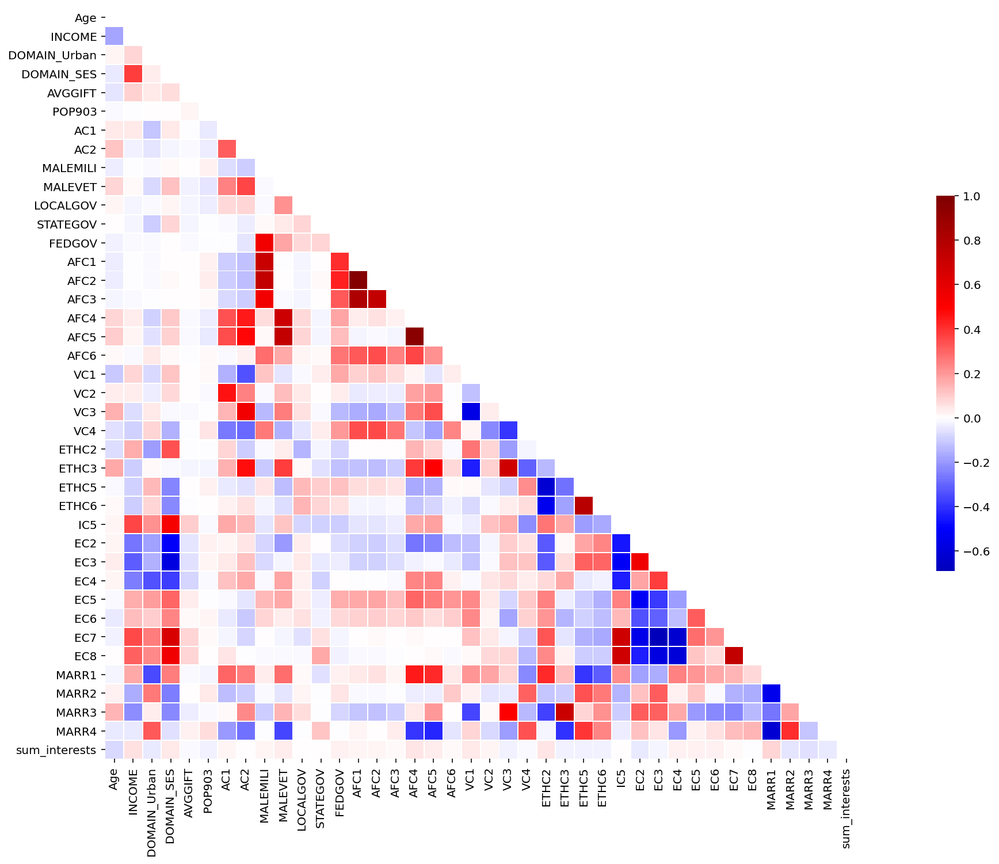

In [50]:
heatmap(data[metric_features],'pearson')

It's hard to interpret quickly because it has too many features!
In order to solve this problem, it was decided to implement some dimensionality reduction techniques to make the heatmap more "readable"

### Data Visualization 

Sometimes, it's easier to have a quick understanding of the data by visualizing it. It was decided to explore what it was talked about previously in Process Thought Section by plotting some variables/features to have some first insights of the donors behaviour.

#### Amount of Donation in $ for State

In [51]:
state_ramntall = data[['STATE','RAMNTALL']].groupby(by = ['STATE']).sum().sort_values(by = ['RAMNTALL'], ascending = False).reset_index()
#state_ramntall

In [52]:
fig = go.Figure(data=go.Choropleth(
    locations=state_ramntall['STATE'], # Spatial coordinates
    z = state_ramntall['RAMNTALL'].astype(float), # Data to be color-coded
    locationmode = 'USA-states', # set of locations match entries in `locations`
    colorscale = 'greens',
    colorbar_title = "Amount of Donations in $",
))

fig.update_layout(
    title_text = 'PVA donations amount in $ by US County',
    geo_scope='usa', # limite map scope to USA
)

fig.show()

#### Age importance for donations

In [53]:
bins = [18, 30, 40, 50, 60, 70, 80,120]
labels = ['0-29', '30-39', '40-49', '50-59', '60-69', '70-79', '80+']
data['AgeRange'] = pd.cut(data.Age, bins, labels = labels,include_lowest = True)

findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=15.0.
findfont: score(<Font 'DejaVu Serif' (DejaVuSerif.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'DejaVu Serif' (DejaVuSerif-Bold.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'DejaVu Sans Mono' (DejaVuSansMono.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'cmtt10' (cmtt10.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'cmmi10' (cmmi10.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'DejaVu Serif' (DejaVuSerif-BoldItalic.ttf) italic normal 700 normal>) = 11.335
findfont: score(<Font 'STIXSizeFiveSym' (STIXSizFiveSymReg.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'STIXGeneral' (STIXGeneral.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'cmb10' (cmb10.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'STIXSizeFourSym' (STIXSizFourSymReg.ttf) normal normal 400 normal>) = 

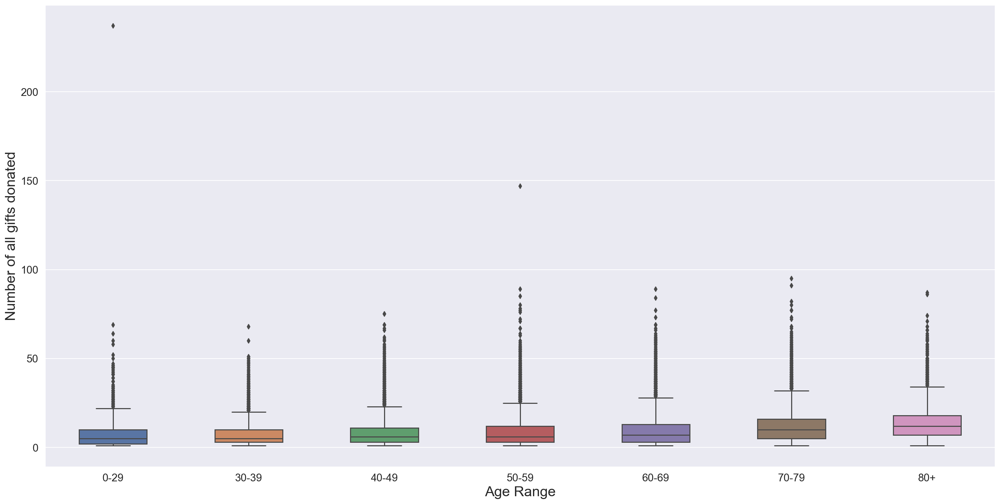

In [54]:
sns.set(rc={'figure.figsize': (24,12)})
ax = sns.boxplot(y='NGIFTALL', x='AgeRange', data=data, width = 0.5)

ax.set_xlabel("Age Range",fontsize=20)
ax.set_ylabel("Number of all gifts donated",fontsize=20)
ax.tick_params(labelsize=15)


plt.show()

#### Gender Distribution

findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=11.0.
findfont: score(<Font 'DejaVu Serif' (DejaVuSerif.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'DejaVu Serif' (DejaVuSerif-Bold.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'DejaVu Sans Mono' (DejaVuSansMono.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'cmtt10' (cmtt10.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'cmmi10' (cmmi10.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'DejaVu Serif' (DejaVuSerif-BoldItalic.ttf) italic normal 700 normal>) = 11.335
findfont: score(<Font 'STIXSizeFiveSym' (STIXSizFiveSymReg.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'STIXGeneral' (STIXGeneral.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'cmb10' (cmb10.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'STIXSizeFourSym' (STIXSizFourSymReg.ttf) normal normal 400 normal>) = 

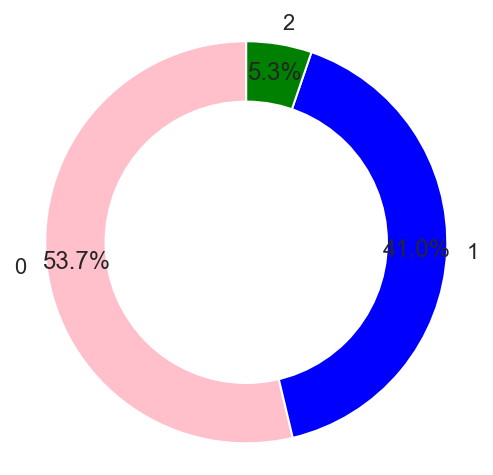

In [55]:
#0 --> Female / 1--> Male / 2 --> Joint Account(not specified)
labels = [0,1,2]
sizes = [data.query('GENDER == 0').GENDER.count(),data.query('GENDER == 1').GENDER.count(),data.query('GENDER == 2').GENDER.count()]
#colors
colors = ['pink','blue','green']
#explsion
explode = (0.05,0.05)
plt.figure(figsize=(4,4)) 
my_circle=plt.Circle( (0,0), 0.7, color='white')
plt.pie(sizes, colors = colors, labels=labels, autopct='%1.1f%%', startangle=90, pctdistance=0.85)
p=plt.gcf()
plt.axis('equal')
p.gca().add_artist(my_circle)
plt.show()

#### Veterans Contributions

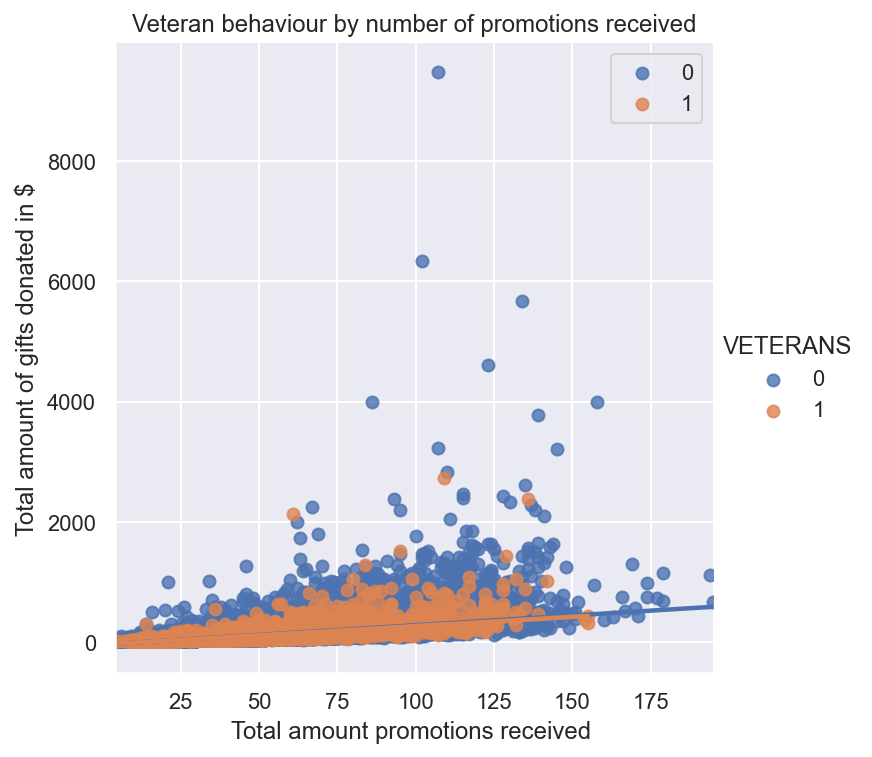

In [56]:
sns.set(rc={'figure.figsize': (24,12)})

ax_reg1 = sns.lmplot(x='NUMPROM', y='RAMNTALL', hue="VETERANS",data=data)

plt.legend()
plt.xlabel("Total amount promotions received ")
plt.ylabel("Total amount of gifts donated in $")
plt.title('Veteran behaviour by number of promotions received')
plt.show()


#### Veteran / Non Veteran 

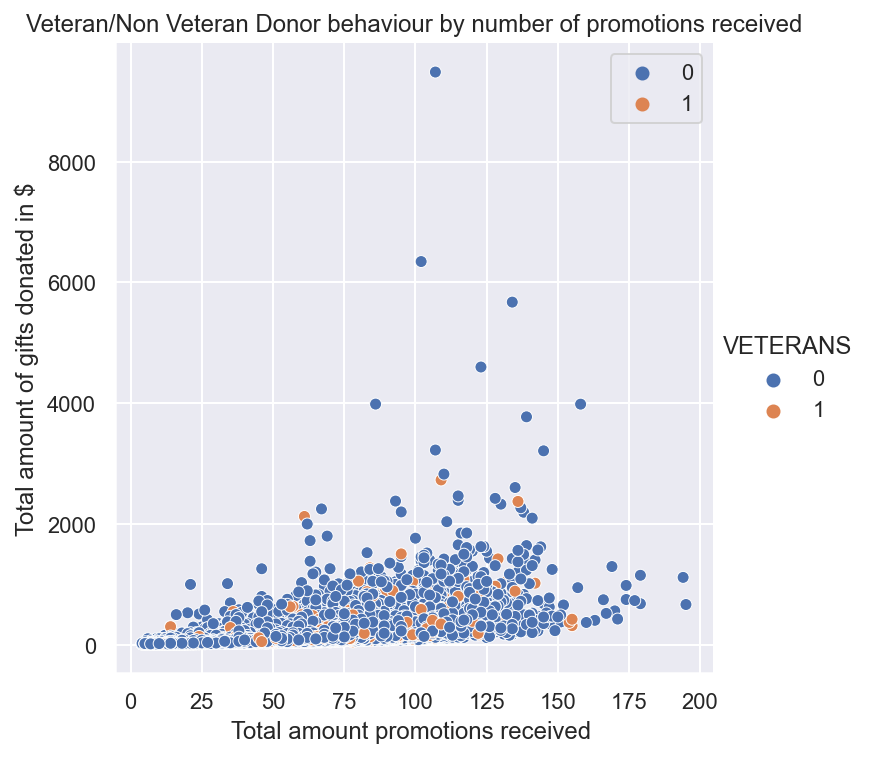

In [57]:
sns.set(rc={'figure.figsize': (24,12)})

ax_reg2 = sns.relplot(x='NUMPROM', y='RAMNTALL', hue="VETERANS",data=data)

plt.legend()
plt.xlabel("Total amount promotions received ")
plt.ylabel("Total amount of gifts donated in $")
plt.title('Veteran/Non Veteran Donor behaviour by number of promotions received')
plt.show()


#### Religious Contributions

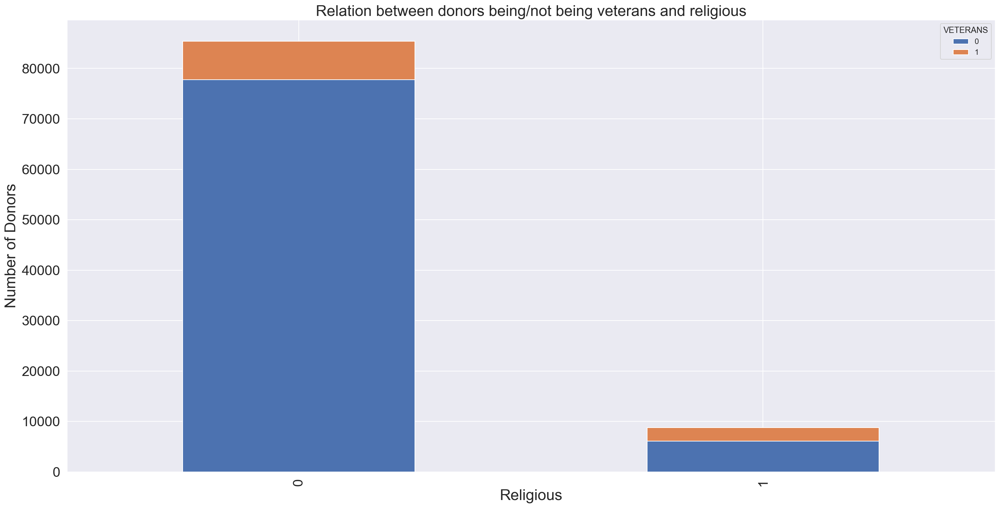

In [195]:
# Being Veteran and Religious --> not too much
sns.set()
categorical_features_counts = data\
    .groupby(['BIBLE', 'VETERANS'])\
    .size()\
    .unstack()\
    .plot.bar(stacked=True)


plt.xlabel('Religious', fontsize = 22)
plt.xticks(fontsize=20)
plt.ylabel('Number of Donors', fontsize = 22)
plt.yticks(fontsize=20)
plt.title('Relation between donors being/not being veterans and religious', fontsize = 22)

plt.show()

### Feature Engineering/Dimensionality reduction

After watching the heatmap above relative to the correlation between the selected features, since some variables got really high values of correlation, it was decided to try a dimensionality reduction technique called Principal Component Analysis(PCA),where features that are highly correlated will be grouped in new features(components) that are not linearly correlated with each other and where the variance will be larger from the first to the last.
- Domain_Urban/IC5/EC(2-7)/MARR(1-4)
- AFC/VC/FEDGOV/STATEGOV/LOCALGOV/MALEVET
- EIC(1-16)

Since using IQR method for identify/remove outliers, gives a prediction of 72% of "useful/clean" data(without any outlier mostly because teh outlier are respectively to huge amount of donatiosn from RAMNTALL and NUMPROM), it was decided that, it would make more sense to use Robust Scaler to mitigate the information loss that could have happen if IQR method was used because, for the topic in question, these " outliers" are an important aspect for the clustering since donors that had made higher donations should be one of the main priorities for the organization PVA

#### Data normalization

It was decided to remove Domain SES and Domain Urban(both ordinal features);

In [59]:
individual_metric = {'Age','INCOME','DOMAIN_Urban','DOMAIN_SES','AVGGIFT','sum_interests'}

metric_features = [e for e in metric_features if e not in individual_metric]


In [60]:
# Use RobustScaler to scale the data
robust_scaler = RobustScaler()
robust_scaled_feat = robust_scaler.fit_transform(data[metric_features])
robust_scaled_feat

array([[-0.32101911,  1.33333333,  0.25      , ..., -0.6       ,
         1.2       , -0.25      ],
       [ 0.52738854,  0.        , -0.25      , ..., -1.2       ,
        -0.6       ,  0.375     ],
       [ 2.65605096,  0.        , -0.25      , ..., -0.2       ,
         0.6       , -0.25      ],
       ...,
       [-0.48280255, -1.        ,  1.25      , ...,  1.8       ,
        -0.2       ,  1.25      ],
       [-0.09681529,  0.        , -0.75      , ..., -0.2       ,
         0.4       ,  0.75      ],
       [ 0.9656051 ,  0.33333333, -0.5       , ..., -0.8       ,
        -0.6       , -0.375     ]])

In [61]:
data[metric_features] = robust_scaled_feat
data[metric_features]

,POP903,AC1,AC2,MALEMILI,MALEVET,LOCALGOV,STATEGOV,FEDGOV,AFC1,AFC2,...,EC3,EC4,EC5,EC6,EC7,EC8,MARR1,MARR2,MARR3,MARR4
CONTROLN,,,,,,,,,,,,,,,,,,,,,
95515,-0.321019,1.333333,0.25,0.00,0.615385,0.8,-0.2,-0.333333,0.00,0.00,...,-0.181818,0.714286,0.000000,0.4,-0.615385,-0.285714,0.000000,-0.6,1.2,-0.250
148535,0.527389,0.000000,-0.25,0.00,-1.230769,0.0,-0.2,-0.333333,0.00,0.00,...,-0.636364,-1.214286,0.000000,0.2,1.384615,2.142857,0.533333,-1.2,-0.6,0.375
15078,2.656051,0.000000,-0.25,0.00,-0.846154,0.0,1.0,-0.333333,0.00,0.00,...,0.727273,-0.071429,-0.555556,0.0,-0.538462,-0.285714,0.133333,-0.2,0.6,-0.250
172556,-0.464968,0.000000,0.00,0.00,-0.615385,-0.6,-0.6,0.333333,0.00,0.00,...,0.000000,-1.071429,0.666667,0.8,-0.692308,0.000000,0.133333,-0.2,0.0,0.250
7112,0.225478,0.333333,1.25,0.01,-0.230769,4.0,0.0,0.000000,0.01,0.01,...,0.727273,0.071429,-0.888889,-0.6,0.000000,0.000000,-1.266667,1.4,0.6,1.500
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
184568,12.042038,-0.666667,-0.75,0.14,0.384615,0.2,1.0,3.666667,0.08,0.15,...,-0.454545,-0.071429,1.333333,0.4,0.230769,0.428571,-0.200000,1.0,-0.6,0.375
122706,-0.284076,-1.000000,-1.00,0.00,0.000000,-0.4,-0.4,-0.666667,0.00,0.00,...,-0.545455,-1.214286,0.333333,0.2,1.846154,1.285714,0.800000,-1.2,-0.8,-0.125
189641,-0.482803,-1.000000,1.25,0.00,-1.000000,0.2,4.0,-0.666667,0.00,0.00,...,-0.818182,1.571429,0.222222,0.2,-0.076923,-0.714286,-1.066667,1.8,-0.2,1.250


In [62]:
df1_pca = data[['DOMAIN_Urban','IC5','EC2','EC3','EC4','EC5','EC6','EC7','MARR1','MARR2','MARR3','MARR4']]
df2_pca = data[['AC1','AC2','MALEMILI','MALEVET','LOCALGOV','STATEGOV','FEDGOV','AFC1','AFC2','AFC3','AFC4','AFC5','AFC6','VC1','VC2','VC3','VC4']]
df3_pca = data[['EIC1','EIC2','EIC3','EIC4','EIC5','EIC6','EIC7','EIC8','EIC9','EIC10','EIC11','EIC12','EIC13','EIC14','EIC15','EIC16']]

In [63]:
df1_pca_features = df1_pca.columns.to_list()
df2_pca_features = df2_pca.columns.to_list()
df3_pca_features = df3_pca.columns.to_list()

#### First PCA

In [64]:
pca = PCA()
pca1_feat = pca.fit_transform(df1_pca)
pca1_feat  

array([[-1.46373138e+00, -6.44141599e-01,  5.29268621e-01, ...,
        -5.85138625e-02, -7.23625972e-01, -2.52384343e-02],
       [ 2.77124686e+00, -1.71651734e+00,  7.69983745e-02, ...,
         4.09437046e-01, -4.08141464e-02, -7.52475644e-04],
       [-2.35346774e+00, -7.22081971e-01, -5.22498011e-02, ...,
         2.37851693e-01, -7.48860403e-02,  1.02516810e-02],
       ...,
       [ 4.91399701e-01,  1.83021772e+00, -7.71767358e-01, ...,
        -1.19438251e+00, -9.38729644e-01, -1.20028233e-01],
       [ 1.55312547e+00,  4.79593687e-01, -1.88939952e-01, ...,
         3.11879580e-01, -4.04255350e-01, -5.12843788e-02],
       [ 1.81490477e+00, -1.17649778e+00, -1.09838733e-01, ...,
        -4.02038903e-01,  5.13732205e-01, -7.03238895e-02]])

In [65]:
cov_matrix1 = df1_pca.cov()
cov_matrix1

,DOMAIN_Urban,IC5,EC2,EC3,EC4,EC5,EC6,EC7,MARR1,MARR2,MARR3,MARR4
DOMAIN_Urban,1.727034,0.334794,-0.227673,-0.136770,-0.326298,0.196079,0.087815,0.253700,-0.398931,0.310795,0.044676,0.473634
IC5,0.334794,1.343725,-0.486191,-0.412475,-0.371299,0.223547,0.110430,0.597532,0.223056,-0.150519,-0.103001,-0.041757
EC2,-0.227673,-0.486191,0.843951,0.351477,0.119452,-0.376992,-0.210867,-0.382244,-0.140495,0.097062,0.284680,0.124860
EC3,-0.136770,-0.412475,0.351477,0.477431,0.191244,-0.208597,-0.144211,-0.357327,-0.094223,0.197904,0.209921,0.041614
EC4,-0.326298,-0.371299,0.119452,0.191244,0.536365,-0.109971,-0.062988,-0.342807,0.152749,0.017949,0.121594,-0.163681
EC5,0.196079,0.223547,-0.376992,-0.208597,-0.109971,0.625187,0.169633,0.165752,0.138506,0.078211,-0.152884,0.023124
EC6,0.087815,0.110430,-0.210867,-0.144211,-0.062988,0.169633,0.461875,0.106262,0.098728,-0.006707,-0.149578,0.046454
EC7,0.253700,0.597532,-0.382244,-0.357327,-0.342807,0.165752,0.106262,0.560140,0.094092,-0.102723,-0.172391,0.106222
MARR1,-0.398931,0.223056,-0.140495,-0.094223,0.152749,0.138506,0.098728,0.094092,0.743433,-0.425052,-0.222444,-0.592201
MARR2,0.310795,-0.150519,0.097062,0.197904,0.017949,0.078211,-0.006707,-0.102723,-0.425052,0.813992,0.158484,0.410323


In [66]:
# Composing back the covariance matrix
pd.DataFrame(pca.components_.T @ np.diag(pca.explained_variance_) @ pca.components_, 
             index=cov_matrix1.index, 
             columns=cov_matrix1.columns)

,DOMAIN_Urban,IC5,EC2,EC3,EC4,EC5,EC6,EC7,MARR1,MARR2,MARR3,MARR4
DOMAIN_Urban,1.727034,0.334794,-0.227673,-0.136770,-0.326298,0.196079,0.087815,0.253700,-0.398931,0.310795,0.044676,0.473634
IC5,0.334794,1.343725,-0.486191,-0.412475,-0.371299,0.223547,0.110430,0.597532,0.223056,-0.150519,-0.103001,-0.041757
EC2,-0.227673,-0.486191,0.843951,0.351477,0.119452,-0.376992,-0.210867,-0.382244,-0.140495,0.097062,0.284680,0.124860
EC3,-0.136770,-0.412475,0.351477,0.477431,0.191244,-0.208597,-0.144211,-0.357327,-0.094223,0.197904,0.209921,0.041614
EC4,-0.326298,-0.371299,0.119452,0.191244,0.536365,-0.109971,-0.062988,-0.342807,0.152749,0.017949,0.121594,-0.163681
EC5,0.196079,0.223547,-0.376992,-0.208597,-0.109971,0.625187,0.169633,0.165752,0.138506,0.078211,-0.152884,0.023124
EC6,0.087815,0.110430,-0.210867,-0.144211,-0.062988,0.169633,0.461875,0.106262,0.098728,-0.006707,-0.149578,0.046454
EC7,0.253700,0.597532,-0.382244,-0.357327,-0.342807,0.165752,0.106262,0.560140,0.094092,-0.102723,-0.172391,0.106222
MARR1,-0.398931,0.223056,-0.140495,-0.094223,0.152749,0.138506,0.098728,0.094092,0.743433,-0.425052,-0.222444,-0.592201
MARR2,0.310795,-0.150519,0.097062,0.197904,0.017949,0.078211,-0.006707,-0.102723,-0.425052,0.813992,0.158484,0.410323


In [67]:
# Obtaining the projected observations on the principal components axes (linear combinations)
pd.DataFrame(df1_pca.values @ pca.components_.T, 
             index=df1_pca.index,
             columns=[f"PC{i}" for i in range(pca.n_components_)])

,PC0,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11
CONTROLN,,,,,,,,,,,,
95515,-0.066024,1.010214,1.735069,-0.940201,-0.912420,0.041214,-1.351988,0.002602,0.026608,-0.228801,-0.722839,-0.188200
148535,4.168954,-0.062162,1.282799,0.611466,-1.900965,0.901045,-0.604526,-0.130757,0.056723,0.239150,-0.040028,-0.163714
15078,-0.955761,0.932273,1.153551,-0.083553,-1.153395,0.620485,-0.617696,-0.771207,-0.116991,0.067565,-0.074100,-0.152710
172556,0.024849,0.941049,0.336886,0.084546,-1.039527,0.598792,-1.263105,-2.208015,0.108824,0.277818,-0.914791,-0.014507
7112,0.355155,3.943191,0.926103,-0.269700,-0.932052,0.697418,0.116863,0.204934,-0.089821,-0.498400,0.279380,-0.146487
...,...,...,...,...,...,...,...,...,...,...,...,...
184568,3.130396,2.029399,0.686317,-2.155159,-0.359760,0.900122,-0.159458,-0.236580,0.241466,-0.268770,-0.446478,-0.165691
122706,4.307134,0.147188,1.314760,-0.895788,-2.287934,0.416990,-0.321555,-0.311846,0.213341,-0.188538,0.680041,-0.349093
189641,1.889107,3.484573,0.434033,-2.073894,-0.163744,0.858029,-0.253996,1.169955,-0.228915,-1.364669,-0.937943,-0.282990


In [68]:
# Output PCA table
pd.DataFrame(
    {"Eigenvalue": pca.explained_variance_,
     "Difference": np.insert(np.diff(pca.explained_variance_), 0, 0),
     "Proportion": pca.explained_variance_ratio_,
     "Cumulative": np.cumsum(pca.explained_variance_ratio_)},
    index=range(1, pca.n_components_ + 1)
)

,Eigenvalue,Difference,Proportion,Cumulative
1,2.969254,0.000000,0.287833,0.287833
2,2.534401,-0.434853,0.245680,0.533513
3,1.142121,-1.392279,0.110715,0.644228
4,0.917924,-0.224197,0.088982,0.733209
5,0.745584,-0.172340,0.072275,0.805485
6,0.471289,-0.274295,0.045686,0.851171
7,0.413695,-0.057594,0.040103,0.891273
8,0.377446,-0.036249,0.036589,0.927862
9,0.335564,-0.041882,0.032529,0.960391
10,0.200481,-0.135083,0.019434,0.979825


findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=14.0.
findfont: score(<Font 'DejaVu Serif' (DejaVuSerif.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'DejaVu Serif' (DejaVuSerif-Bold.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'DejaVu Sans Mono' (DejaVuSansMono.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'cmtt10' (cmtt10.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'cmmi10' (cmmi10.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'DejaVu Serif' (DejaVuSerif-BoldItalic.ttf) italic normal 700 normal>) = 11.335
findfont: score(<Font 'STIXSizeFiveSym' (STIXSizFiveSymReg.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'STIXGeneral' (STIXGeneral.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'cmb10' (cmb10.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'STIXSizeFourSym' (STIXSizFourSymReg.ttf) normal normal 400 normal>) = 

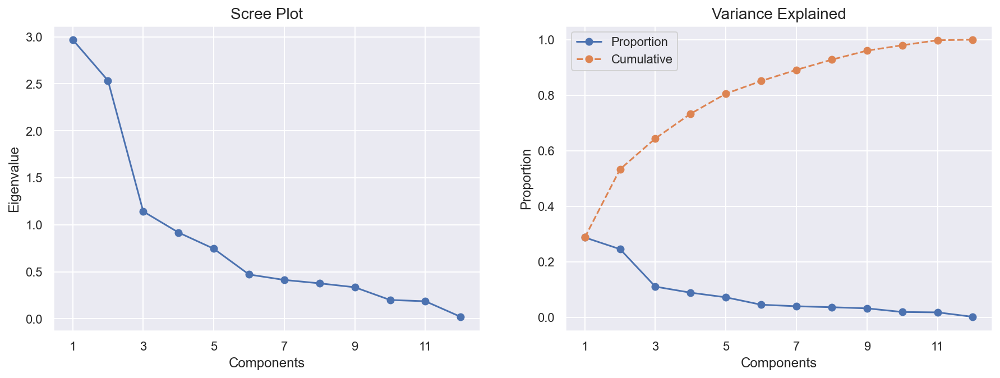

In [69]:
# figure and axes
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))

# draw plots
ax1.plot(pca.explained_variance_, marker=".", markersize=12)
ax2.plot(pca.explained_variance_ratio_, marker=".", markersize=12, label="Proportion")
ax2.plot(np.cumsum(pca.explained_variance_ratio_), marker=".", markersize=12, linestyle="--", label="Cumulative")

# customizations
ax2.legend()
ax1.set_title("Scree Plot", fontsize=14)
ax2.set_title("Variance Explained", fontsize=14)
ax1.set_ylabel("Eigenvalue")
ax2.set_ylabel("Proportion")
ax1.set_xlabel("Components")
ax2.set_xlabel("Components")
ax1.set_xticks(range(0, pca.n_components_, 2))
ax1.set_xticklabels(range(1, pca.n_components_ + 1, 2))
ax2.set_xticks(range(0, pca.n_components_, 2))
ax2.set_xticklabels(range(1, pca.n_components_ + 1, 2))

plt.show()

In [70]:
# Perform PCA again with the number of principal components you want to retain
pca = PCA(n_components=4)
pca_feat = pca.fit_transform(df1_pca)
pca_feat_names = [f"PC{i}" for i in range(pca.n_components_)]
pca_df1 = pd.DataFrame(pca_feat, index=df1_pca.index, columns=pca_feat_names)  # remember index=df_pca.index
pca_df1

,PC0,PC1,PC2,PC3
CONTROLN,,,,
95515,-1.463731,-0.644142,0.529269,0.030194
148535,2.771247,-1.716517,0.076998,1.581860
15078,-2.353468,-0.722082,-0.052250,0.886842
172556,-1.372858,-0.713307,-0.868914,1.054940
7112,-1.042552,2.288836,-0.279698,0.700694
...,...,...,...,...
184568,1.732689,0.375044,-0.519483,-1.184765
122706,2.909427,-1.507167,0.108960,0.074607
189641,0.491400,1.830218,-0.771767,-1.103499


In [71]:
df1_pca = pd.concat([df1_pca, pca_df1], axis=1)
df1_pca.head()

,DOMAIN_Urban,IC5,EC2,EC3,EC4,EC5,EC6,EC7,MARR1,MARR2,MARR3,MARR4,PC0,PC1,PC2,PC3
CONTROLN,,,,,,,,,,,,,,,,
95515,2.0,-0.115609,1.111111,-0.181818,0.714286,0.000000,0.4,-0.615385,0.000000,-0.6,1.2,-0.250,-1.463731,-0.644142,0.529269,0.030194
148535,3.0,3.037498,-0.111111,-0.636364,-1.214286,0.000000,0.2,1.384615,0.533333,-1.2,-0.6,0.375,2.771247,-1.716517,0.076998,1.581860
15078,1.0,-0.292541,1.777778,0.727273,-0.071429,-0.555556,0.0,-0.538462,0.133333,-0.2,0.6,-0.250,-2.353468,-0.722082,-0.052250,0.886842
172556,1.0,0.188575,2.444444,0.000000,-1.071429,0.666667,0.8,-0.692308,0.133333,-0.2,0.0,0.250,-1.372858,-0.713307,-0.868914,1.054940
7112,3.0,-0.528090,1.111111,0.727273,0.071429,-0.888889,-0.6,0.000000,-1.266667,1.4,0.6,1.500,-1.042552,2.288836,-0.279698,0.700694


In [72]:
def _color_red_or_green(val):
    if val < -0.45:
        color = 'background-color: red'
    elif val > 0.45:
        color = 'background-color: green'
    else:
        color = ''
    return color

# Interpreting each Principal Component
loadings = df1_pca.corr().loc[pca_feat_names]
loadings.drop(['PC0','PC1','PC2','PC3'],axis = 1, inplace = True)
loadings.style.applymap(_color_red_or_green)

,DOMAIN_Urban,IC5,EC2,EC3,EC4,EC5,EC6,EC7,MARR1,MARR2,MARR3,MARR4
PC0,0.616002,0.758302,-0.673195,-0.676002,-0.617076,0.500014,0.342113,0.809315,-0.005811,-0.007842,-0.312502,0.231409
PC1,0.575712,-0.300943,0.342500,0.356335,-0.110096,-0.136341,-0.128800,-0.213010,-0.840459,0.680688,0.269105,0.732243
PC2,0.299845,0.253772,0.116477,0.107950,0.009588,-0.179399,-0.270405,-0.030055,0.037156,-0.051570,0.759120,-0.473375
PC3,-0.352614,0.402619,0.284500,-0.052452,-0.322889,-0.401468,-0.262980,0.297617,-0.205597,-0.070521,0.175714,0.302815


Conclusions from first pca:
- PC0: Higher SES, Higher Income, Higher Neighbourhood Income, Higher Education,Higher % People Married;
- PC1: Higher Domain Urban, More frequent Higher Education, Higher % of Divorced/Separated and Single/Not married;
- PC2: Both low education/higher education(standard neighbourhood) , Highest % Widow People that can inflate the IC5;
- PC3: Lower Domain Urban, Low lvl of education;

In [73]:
pca_df1.rename(columns = {'PC0': 'Rich_Neigh','PC1':'Single_Neigh', 'PC2':'Standard_Neigh','PC3':'Poor/Lower Neigh'},inplace = True)

#### Second Data

In [74]:
pca = PCA()

In [75]:
pca2_feat = pca.fit_transform(df2_pca)
pca2_feat  
#cov
cov_matrix2 = df2_pca.cov()
cov_matrix2

,AC1,AC2,MALEMILI,MALEVET,LOCALGOV,STATEGOV,FEDGOV,AFC1,AFC2,AFC3,AFC4,AFC5,AFC6,VC1,VC2,VC3,VC4
AC1,0.916094,0.246517,-0.003208,0.207008,0.062567,-0.012666,-0.004308,-0.002839,-0.004392,-0.000742,0.247129,0.293383,-0.012116,-0.115921,0.392924,0.110867,-0.218344
AC2,0.246517,0.661527,-0.004092,0.257206,0.054866,-0.027314,-0.055754,-0.003056,-0.004906,-0.000803,0.274233,0.348187,0.018515,-0.220521,0.176480,0.361810,-0.211937
MALEMILI,-0.003208,-0.004092,0.002485,-0.000243,-0.000721,0.000597,0.037536,0.001102,0.001776,0.000280,0.002425,0.000502,0.011659,0.004394,-0.000550,-0.005671,0.011717
MALEVET,0.207008,0.257206,-0.000243,0.773971,0.166218,0.042175,0.218568,-0.000097,0.000269,-0.000049,0.463009,0.566965,0.120028,-0.038582,0.099943,0.179618,-0.117513
LOCALGOV,0.062567,0.054866,-0.000721,0.166218,0.770310,0.068318,0.088801,-0.000565,-0.000891,-0.000165,0.048068,0.063986,0.014248,-0.006633,0.035825,0.041698,-0.036047
STATEGOV,-0.012666,-0.027314,0.000597,0.042175,0.068318,1.049260,0.109257,0.000271,0.000587,0.000081,-0.018206,-0.019637,0.012345,0.033647,0.002460,-0.005108,0.035816
FEDGOV,-0.004308,-0.055754,0.037536,0.218568,0.088801,0.109257,1.894061,0.017486,0.028744,0.004562,0.183338,0.156215,0.302446,0.184040,0.040477,-0.152212,0.241426
AFC1,-0.002839,-0.003056,0.001102,-0.000097,-0.000565,0.000271,0.017486,0.000961,0.001465,0.000259,0.000951,-0.000628,0.008242,0.002307,-0.001109,-0.003929,0.009575
AFC2,-0.004392,-0.004906,0.001776,0.000269,-0.000891,0.000587,0.028744,0.001465,0.002326,0.000365,0.002089,-0.000364,0.013707,0.004314,-0.001429,-0.006440,0.015217
AFC3,-0.000742,-0.000803,0.000280,-0.000049,-0.000165,0.000081,0.004562,0.000259,0.000365,0.000105,0.000186,-0.000212,0.002071,0.000546,-0.000326,-0.001015,0.002494


In [76]:
pd.DataFrame(pca.components_.T @ np.diag(pca.explained_variance_) @ pca.components_, 
             index=cov_matrix2.index, 
             columns=cov_matrix2.columns)

,AC1,AC2,MALEMILI,MALEVET,LOCALGOV,STATEGOV,FEDGOV,AFC1,AFC2,AFC3,AFC4,AFC5,AFC6,VC1,VC2,VC3,VC4
AC1,0.916094,0.246517,-0.003208,0.207008,0.062567,-0.012666,-0.004308,-0.002839,-0.004392,-0.000742,0.247129,0.293383,-0.012116,-0.115921,0.392924,0.110867,-0.218344
AC2,0.246517,0.661527,-0.004092,0.257206,0.054866,-0.027314,-0.055754,-0.003056,-0.004906,-0.000803,0.274233,0.348187,0.018515,-0.220521,0.176480,0.361810,-0.211937
MALEMILI,-0.003208,-0.004092,0.002485,-0.000243,-0.000721,0.000597,0.037536,0.001102,0.001776,0.000280,0.002425,0.000502,0.011659,0.004394,-0.000550,-0.005671,0.011717
MALEVET,0.207008,0.257206,-0.000243,0.773971,0.166218,0.042175,0.218568,-0.000097,0.000269,-0.000049,0.463009,0.566965,0.120028,-0.038582,0.099943,0.179618,-0.117513
LOCALGOV,0.062567,0.054866,-0.000721,0.166218,0.770310,0.068318,0.088801,-0.000565,-0.000891,-0.000165,0.048068,0.063986,0.014248,-0.006633,0.035825,0.041698,-0.036047
STATEGOV,-0.012666,-0.027314,0.000597,0.042175,0.068318,1.049260,0.109257,0.000271,0.000587,0.000081,-0.018206,-0.019637,0.012345,0.033647,0.002460,-0.005108,0.035816
FEDGOV,-0.004308,-0.055754,0.037536,0.218568,0.088801,0.109257,1.894061,0.017486,0.028744,0.004562,0.183338,0.156215,0.302446,0.184040,0.040477,-0.152212,0.241426
AFC1,-0.002839,-0.003056,0.001102,-0.000097,-0.000565,0.000271,0.017486,0.000961,0.001465,0.000259,0.000951,-0.000628,0.008242,0.002307,-0.001109,-0.003929,0.009575
AFC2,-0.004392,-0.004906,0.001776,0.000269,-0.000891,0.000587,0.028744,0.001465,0.002326,0.000365,0.002089,-0.000364,0.013707,0.004314,-0.001429,-0.006440,0.015217
AFC3,-0.000742,-0.000803,0.000280,-0.000049,-0.000165,0.000081,0.004562,0.000259,0.000365,0.000105,0.000186,-0.000212,0.002071,0.000546,-0.000326,-0.001015,0.002494


In [77]:
pd.DataFrame(df2_pca.values @ pca.components_.T, 
             index=df2_pca.index,
             columns=[f"PC{i}" for i in range(pca.n_components_)])

,PC0,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16
CONTROLN,,,,,,,,,,,,,,,,,
95515,1.040668,-0.280403,0.233370,0.605010,1.173427,0.260706,0.968199,-0.978386,0.018974,0.298484,0.022562,-0.019675,-0.087378,0.013169,-0.003820,0.000130,0.000071
148535,-2.151066,-0.034349,0.357798,0.905586,0.559613,0.881697,-0.747652,0.368479,0.751453,0.772194,0.354977,-0.039720,0.045100,0.019413,0.002281,-0.000332,-0.000333
15078,-1.101077,-0.360374,1.405533,0.309354,-0.329447,-0.196360,0.030176,0.125703,-0.202757,0.047951,-0.173384,0.093613,0.037264,0.012460,0.000199,-0.000358,-0.000306
172556,-0.301317,-0.126746,0.198877,1.756472,-0.797611,-0.966102,0.579064,-0.059832,-1.477772,-0.185586,-0.226728,0.075884,0.273311,-0.017506,0.001396,-0.000312,-0.000295
7112,1.116621,-0.050558,0.408823,-1.006541,-1.303644,1.642568,3.745359,1.044165,0.612721,0.957995,-0.095024,0.022754,0.036694,-0.009042,-0.004863,0.008282,-0.002258
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
184568,0.727312,4.703120,0.109607,-0.579015,0.438974,-0.518317,0.267100,0.751924,0.060411,-0.064604,-0.055507,-0.066019,0.062082,0.086260,0.002302,-0.008690,-0.007627
122706,-0.613396,1.015958,-1.837906,-1.577428,1.491167,-1.097991,0.616856,2.359949,0.970997,-0.560793,0.277120,-0.222045,0.232036,-0.054125,-0.014273,0.001884,0.001098
189641,-2.084915,0.381477,3.010007,-2.721806,0.079756,-0.433721,-0.397672,-0.342683,0.260869,2.178336,0.550360,-0.054039,0.022912,0.014618,-0.006267,-0.000432,-0.000368


In [78]:
# Output PCA table
pd.DataFrame(
    {"Eigenvalue": pca.explained_variance_,
     "Difference": np.insert(np.diff(pca.explained_variance_), 0, 0),
     "Proportion": pca.explained_variance_ratio_,
     "Cumulative": np.cumsum(pca.explained_variance_ratio_)},
    index=range(1, pca.n_components_ + 1)
)

,Eigenvalue,Difference,Proportion,Cumulative
1,2.630563,0.000000,0.240258,0.240258
2,2.181616,-0.448947,0.199254,0.439513
3,1.063409,-1.118207,0.097125,0.536638
4,1.037232,-0.026177,0.094734,0.631372
5,0.895283,-0.141949,0.081769,0.713141
6,0.770029,-0.125255,0.070329,0.783470
7,0.712552,-0.057477,0.065080,0.848550
8,0.496701,-0.215851,0.045365,0.893916
9,0.430410,-0.066291,0.039311,0.933226
10,0.336097,-0.094313,0.030697,0.963923


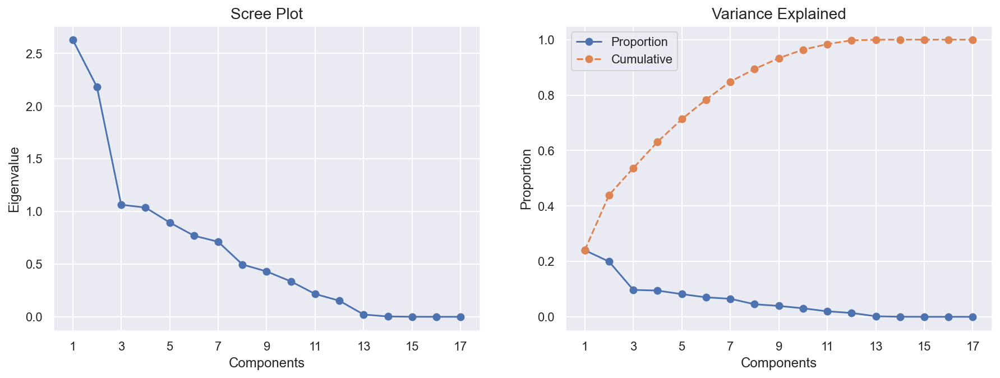

In [79]:
# figure and axes
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))

# draw plots
ax1.plot(pca.explained_variance_, marker=".", markersize=12)
ax2.plot(pca.explained_variance_ratio_, marker=".", markersize=12, label="Proportion")
ax2.plot(np.cumsum(pca.explained_variance_ratio_), marker=".", markersize=12, linestyle="--", label="Cumulative")

# customizations
ax2.legend()
ax1.set_title("Scree Plot", fontsize=14)
ax2.set_title("Variance Explained", fontsize=14)
ax1.set_ylabel("Eigenvalue")
ax2.set_ylabel("Proportion")
ax1.set_xlabel("Components")
ax2.set_xlabel("Components")
ax1.set_xticks(range(0, pca.n_components_, 2))
ax1.set_xticklabels(range(1, pca.n_components_ + 1, 2))
ax2.set_xticks(range(0, pca.n_components_, 2))
ax2.set_xticklabels(range(1, pca.n_components_ + 1, 2))

plt.show()

In [80]:
# Perform PCA again with the number of principal components you want to retain
pca = PCA(n_components=4)
pca_feat = pca.fit_transform(df2_pca)
pca_feat_names = [f"PC{i}" for i in range(pca.n_components_)]
pca_df2 = pd.DataFrame(pca_feat, index=df2_pca.index, columns=pca_feat_names)  # remember index=df_pca.index
pca_df2

,PC0,PC1,PC2,PC3
CONTROLN,,,,
95515,0.905518,-0.705231,-0.019173,0.743390
148535,-2.286216,-0.459178,0.105255,1.043966
15078,-1.236227,-0.785203,1.152990,0.447734
172556,-0.436467,-0.551575,-0.053667,1.894853
7112,0.981471,-0.475387,0.156279,-0.868160
...,...,...,...,...
184568,0.592163,4.278291,-0.142936,-0.440634
122706,-0.748546,0.591129,-2.090450,-1.439048
189641,-2.220065,-0.043352,2.757464,-2.583425


In [81]:
df2_pca = pd.concat([df2_pca, pca_df2], axis=1)
df2_pca.head()

,AC1,AC2,MALEMILI,MALEVET,LOCALGOV,STATEGOV,FEDGOV,AFC1,AFC2,AFC3,...,AFC5,AFC6,VC1,VC2,VC3,VC4,PC0,PC1,PC2,PC3
CONTROLN,,,,,,,,,,,,,,,,,,,,,
95515,1.333333,0.25,0.00,0.615385,0.8,-0.2,-0.333333,0.00,0.00,0.00,...,0.666667,-0.5,0.222222,0.545455,-0.666667,0.583333,0.905518,-0.705231,-0.019173,0.743390
148535,0.000000,-0.25,0.00,-1.230769,0.0,-0.2,-0.333333,0.00,0.00,0.00,...,-1.333333,-0.5,1.388889,-0.636364,-1.000000,-0.750000,-2.286216,-0.459178,0.105255,1.043966
15078,0.000000,-0.25,0.00,-0.846154,0.0,1.0,-0.333333,0.00,0.00,0.00,...,-0.833333,-0.5,-0.111111,0.545455,0.000000,-0.083333,-1.236227,-0.785203,1.152990,0.447734
172556,0.000000,0.00,0.00,-0.615385,-0.6,-0.6,0.333333,0.00,0.00,0.00,...,-0.666667,-0.5,-0.888889,2.090909,-0.047619,0.583333,-0.436467,-0.551575,-0.053667,1.894853
7112,0.333333,1.25,0.01,-0.230769,4.0,0.0,0.000000,0.01,0.01,0.01,...,-0.250000,1.5,-1.166667,-0.090909,1.000000,0.916667,0.981471,-0.475387,0.156279,-0.868160


In [82]:
def _color_red_or_green(val):
    if val < -0.45:
        color = 'background-color: red'
    elif val > 0.45:
        color = 'background-color: green'
    else:
        color = ''
    return color

# Interpreting each Principal Component
loadings = df2_pca.corr().loc[pca_feat_names]
loadings.drop(['PC0','PC1','PC2','PC3'],axis = 1, inplace = True)
loadings.style.applymap(_color_red_or_green)

,AC1,AC2,MALEMILI,MALEVET,LOCALGOV,STATEGOV,FEDGOV,AFC1,AFC2,AFC3,AFC4,AFC5,AFC6,VC1,VC2,VC3,VC4
PC0,0.561171,0.646356,0.067960,0.771974,0.204702,0.014179,0.290221,0.007771,0.020804,0.001814,0.850113,0.873061,0.260845,-0.199254,0.404760,0.473150,-0.313844
PC1,-0.231670,-0.332856,0.554064,0.058592,0.055032,0.155761,0.894880,0.472423,0.498008,0.370580,0.058440,-0.031034,0.375998,0.382044,-0.152095,-0.433028,0.471725
PC2,0.263062,-0.023776,-0.055329,-0.096193,0.225534,0.842810,0.040277,-0.090698,-0.093332,-0.068643,-0.221758,-0.193435,-0.236136,-0.004105,0.327508,-0.036315,-0.183002
PC3,0.499086,-0.065140,0.079786,-0.282645,-0.131546,-0.466302,0.177734,0.003718,0.004752,0.004028,-0.207133,-0.214884,-0.219758,0.074374,0.590151,-0.250606,-0.207916


- PC0 -->  Adults with more than 55 years(neighbourhood), High % MaleVET in the neighbourhood,Percent WW2 Age 16+;
- PC1 --> Younger people living around, Active Militar %, High %federal gov employers,High %Veterans from IRAQ p.e;
- PC2 --> Adults with age 55-59, Korean % Veteran,More relative to STATEGOV;
- PC3 --> Adults with 55-59 , Vietnam War;

In [83]:
pca_df2.rename(columns = {'PC0':'WW2','PC1':'Fed_Act','PC2':'Korean','PC3':'Vietnam'}, inplace = True)

In [84]:
pca_df2

,WW2,Fed_Act,Korean,Vietnam
CONTROLN,,,,
95515,0.905518,-0.705231,-0.019173,0.743390
148535,-2.286216,-0.459178,0.105255,1.043966
15078,-1.236227,-0.785203,1.152990,0.447734
172556,-0.436467,-0.551575,-0.053667,1.894853
7112,0.981471,-0.475387,0.156279,-0.868160
...,...,...,...,...
184568,0.592163,4.278291,-0.142936,-0.440634
122706,-0.748546,0.591129,-2.090450,-1.439048
189641,-2.220065,-0.043352,2.757464,-2.583425


#### Third Data

In [85]:
df3_pca = data[['EIC1','EIC2','EIC3','EIC4','EIC5','EIC6','EIC7','EIC8','EIC9','EIC10','EIC11','EIC12','EIC13','EIC14','EIC15','EIC16']]

In [86]:
pca = PCA()

In [87]:
pca3_feat = pca.fit_transform(df3_pca)
pca3_feat  
#cov
cov_matrix3 = df3_pca.cov()
cov_matrix3

,EIC1,EIC2,EIC3,EIC4,EIC5,EIC6,EIC7,EIC8,EIC9,EIC10,EIC11,EIC12,EIC13,EIC14,EIC15,EIC16
EIC1,0.003098,0.000061,0.000154,-0.000314,-0.000070,-0.000098,-0.000158,-0.000421,-0.000623,-0.000270,-0.000056,-0.000117,-0.000305,-0.000041,-4.505785e-04,-9.980255e-05
EIC2,0.000061,0.000603,0.000001,-0.000323,-0.000010,0.000018,-0.000023,-0.000050,-0.000086,-0.000039,-0.000013,-0.000022,-0.000048,0.000037,-4.141149e-05,3.112923e-06
EIC3,0.000154,0.000001,0.001699,-0.000129,0.000008,0.000035,-0.000076,0.000076,-0.000281,0.000012,0.000077,-0.000005,-0.000283,-0.000357,-3.295651e-04,-1.540402e-05
EIC4,-0.000314,-0.000323,-0.000129,0.010332,-0.000110,-0.000248,-0.000077,-0.000808,-0.001364,-0.000350,-0.000616,-0.000442,-0.000700,-0.001076,-1.247028e-03,-9.934651e-04
EIC5,-0.000070,-0.000010,0.000008,-0.000110,0.001024,0.000026,0.000086,-0.000063,-0.000042,0.000036,-0.000017,-0.000037,-0.000091,-0.000216,-1.386544e-04,8.623165e-06
EIC6,-0.000098,0.000018,0.000035,-0.000248,0.000026,0.000546,0.000025,-0.000048,0.000047,0.000014,-0.000042,-0.000004,-0.000028,-0.000026,2.207451e-06,3.605851e-05
EIC7,-0.000158,-0.000023,-0.000076,-0.000077,0.000086,0.000025,0.000961,-0.000104,0.000206,0.000072,-0.000094,-0.000027,-0.000054,-0.000194,2.901631e-05,-1.661658e-04
EIC8,-0.000421,-0.000050,0.000076,-0.000808,-0.000063,-0.000048,-0.000104,0.003812,-0.000209,-0.000002,0.000171,0.000001,-0.000109,-0.000345,-3.401066e-04,-1.952721e-05
EIC9,-0.000623,-0.000086,-0.000281,-0.001364,-0.000042,0.000047,0.000206,-0.000209,0.002169,0.000170,-0.000034,0.000125,0.000115,-0.000083,6.196933e-04,-9.522684e-05
EIC10,-0.000270,-0.000039,0.000012,-0.000350,0.000036,0.000014,0.000072,-0.000002,0.000170,0.000944,0.000031,0.000044,-0.000077,-0.000209,1.083714e-04,-4.976542e-05


In [88]:
pd.DataFrame(pca.components_.T @ np.diag(pca.explained_variance_) @ pca.components_, 
             index=cov_matrix3.index, 
             columns=cov_matrix3.columns)

,EIC1,EIC2,EIC3,EIC4,EIC5,EIC6,EIC7,EIC8,EIC9,EIC10,EIC11,EIC12,EIC13,EIC14,EIC15,EIC16
EIC1,0.003098,0.000061,0.000154,-0.000314,-0.000070,-0.000098,-0.000158,-0.000421,-0.000623,-0.000270,-0.000056,-0.000117,-0.000305,-0.000041,-4.505785e-04,-9.980255e-05
EIC2,0.000061,0.000603,0.000001,-0.000323,-0.000010,0.000018,-0.000023,-0.000050,-0.000086,-0.000039,-0.000013,-0.000022,-0.000048,0.000037,-4.141149e-05,3.112923e-06
EIC3,0.000154,0.000001,0.001699,-0.000129,0.000008,0.000035,-0.000076,0.000076,-0.000281,0.000012,0.000077,-0.000005,-0.000283,-0.000357,-3.295651e-04,-1.540402e-05
EIC4,-0.000314,-0.000323,-0.000129,0.010332,-0.000110,-0.000248,-0.000077,-0.000808,-0.001364,-0.000350,-0.000616,-0.000442,-0.000700,-0.001076,-1.247028e-03,-9.934651e-04
EIC5,-0.000070,-0.000010,0.000008,-0.000110,0.001024,0.000026,0.000086,-0.000063,-0.000042,0.000036,-0.000017,-0.000037,-0.000091,-0.000216,-1.386544e-04,8.623165e-06
EIC6,-0.000098,0.000018,0.000035,-0.000248,0.000026,0.000546,0.000025,-0.000048,0.000047,0.000014,-0.000042,-0.000004,-0.000028,-0.000026,2.207451e-06,3.605851e-05
EIC7,-0.000158,-0.000023,-0.000076,-0.000077,0.000086,0.000025,0.000961,-0.000104,0.000206,0.000072,-0.000094,-0.000027,-0.000054,-0.000194,2.901631e-05,-1.661658e-04
EIC8,-0.000421,-0.000050,0.000076,-0.000808,-0.000063,-0.000048,-0.000104,0.003812,-0.000209,-0.000002,0.000171,0.000001,-0.000109,-0.000345,-3.401066e-04,-1.952721e-05
EIC9,-0.000623,-0.000086,-0.000281,-0.001364,-0.000042,0.000047,0.000206,-0.000209,0.002169,0.000170,-0.000034,0.000125,0.000115,-0.000083,6.196933e-04,-9.522684e-05
EIC10,-0.000270,-0.000039,0.000012,-0.000350,0.000036,0.000014,0.000072,-0.000002,0.000170,0.000944,0.000031,0.000044,-0.000077,-0.000209,1.083714e-04,-4.976542e-05


In [89]:
pd.DataFrame(df3_pca.values @ pca.components_.T, 
             index=df3_pca.index,
             columns=[f"PC{i}" for i in range(pca.n_components_)])

,PC0,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15
CONTROLN,,,,,,,,,,,,,,,,
95515,0.350726,0.083015,-0.073796,0.077599,-0.088126,0.014476,0.004675,-0.011963,-0.106134,-0.026756,-0.015743,0.040010,-0.137279,-0.046669,-0.080172,0.139325
148535,0.053355,0.104875,-0.103625,0.064953,-0.103179,-0.018812,-0.035913,0.040534,-0.105237,-0.039787,0.010942,0.019812,-0.143461,-0.036525,-0.097418,0.126052
15078,0.274271,0.068545,-0.008084,0.092590,-0.032934,-0.001110,-0.036147,0.029410,-0.122333,-0.038331,0.038365,0.061855,-0.129731,-0.033579,-0.118847,0.107548
172556,-0.015880,0.123852,0.316344,0.037489,-0.225063,-0.044681,0.036773,0.043856,-0.132716,0.000490,0.014034,0.075898,-0.148075,-0.041424,-0.114560,0.097297
7112,-0.068311,0.001714,-0.032717,0.253652,-0.016721,0.015604,-0.094312,-0.003838,-0.048491,-0.009344,0.016958,0.090083,-0.154874,-0.033089,-0.101485,0.125167
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
184568,-0.033793,0.104952,-0.051498,0.086102,0.000734,0.029049,0.053175,0.009646,-0.097609,-0.051916,0.037308,0.059252,-0.117382,-0.062757,-0.123274,0.117786
122706,0.021821,0.062990,-0.080571,0.036781,-0.044282,-0.056748,-0.018530,0.049723,-0.080901,-0.095978,-0.001527,0.014005,-0.082052,-0.060687,-0.160149,0.124484
189641,0.060712,0.013763,-0.050600,0.187168,0.059661,0.001340,0.083431,-0.019512,-0.134162,-0.028276,0.021814,0.050761,-0.100204,0.034316,-0.130151,0.154663


In [90]:
# Output PCA table
pd.DataFrame(
    {"Eigenvalue": pca.explained_variance_,
     "Difference": np.insert(np.diff(pca.explained_variance_), 0, 0),
     "Proportion": pca.explained_variance_ratio_,
     "Cumulative": np.cumsum(pca.explained_variance_ratio_)},
    index=range(1, pca.n_components_ + 1)
)

,Eigenvalue,Difference,Proportion,Cumulative
1,0.011191,0.000000,0.318136,0.318136
2,0.004156,-0.007035,0.118142,0.436277
3,0.003788,-0.000368,0.107682,0.543959
4,0.002904,-0.000884,0.082563,0.626523
5,0.002002,-0.000902,0.056914,0.683437
6,0.001957,-0.000045,0.055627,0.739063
7,0.001556,-0.000401,0.044233,0.783297
8,0.001380,-0.000176,0.039241,0.822538
9,0.001260,-0.000120,0.035819,0.858357
10,0.001105,-0.000155,0.031401,0.889757


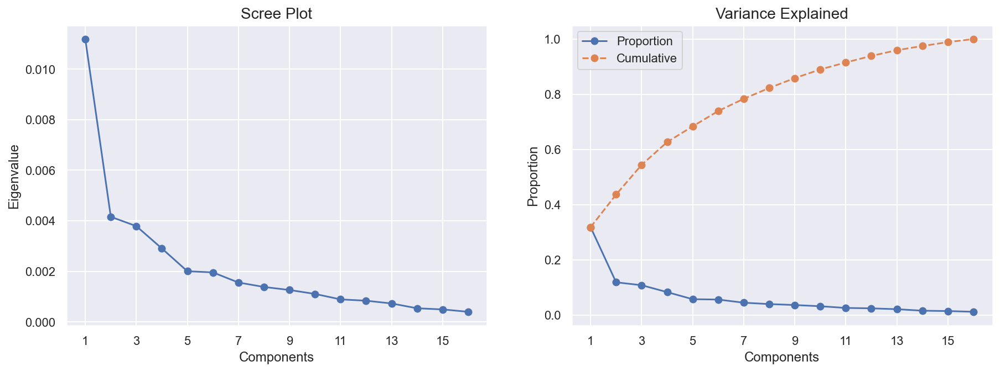

In [91]:
# figure and axes
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))

# draw plots
ax1.plot(pca.explained_variance_, marker=".", markersize=12)
ax2.plot(pca.explained_variance_ratio_, marker=".", markersize=12, label="Proportion")
ax2.plot(np.cumsum(pca.explained_variance_ratio_), marker=".", markersize=12, linestyle="--", label="Cumulative")

# customizations
ax2.legend()
ax1.set_title("Scree Plot", fontsize=14)
ax2.set_title("Variance Explained", fontsize=14)
ax1.set_ylabel("Eigenvalue")
ax2.set_ylabel("Proportion")
ax1.set_xlabel("Components")
ax2.set_xlabel("Components")
ax1.set_xticks(range(0, pca.n_components_, 2))
ax1.set_xticklabels(range(1, pca.n_components_ + 1, 2))
ax2.set_xticks(range(0, pca.n_components_, 2))
ax2.set_xticklabels(range(1, pca.n_components_ + 1, 2))

plt.show()

In [92]:
# Perform PCA again with the number of principal components you want to retain
pca = PCA(n_components=5)
pca_feat = pca.fit_transform(df3_pca)
pca_feat_names = [f"PC{i}" for i in range(pca.n_components_)]
pca_df3 = pd.DataFrame(pca_feat, index=df3_pca.index, columns=pca_feat_names)  # remember index=df_pca.index
pca_df3

,PC0,PC1,PC2,PC3,PC4
CONTROLN,,,,,
95515,0.248970,-0.020018,-0.022304,-0.009526,-0.030138
148535,-0.048401,0.001841,-0.052134,-0.022170,-0.045188
15078,0.172515,-0.034489,0.043406,0.005470,0.025062
172556,-0.117636,0.020818,0.367835,-0.049633,-0.167070
7112,-0.170067,-0.101320,0.018774,0.166530,0.041271
...,...,...,...,...,...
184568,-0.135549,0.001917,-0.000010,-0.001017,0.058732
122706,-0.079935,-0.040047,-0.029088,-0.050329,0.013728
189641,-0.041044,-0.089272,0.000886,0.100053,0.117664


In [93]:
df3_pca = pd.concat([df3_pca, pca_df3], axis=1)
df3_pca.head()

,EIC1,EIC2,EIC3,EIC4,EIC5,EIC6,EIC7,EIC8,EIC9,EIC10,...,EIC12,EIC13,EIC14,EIC15,EIC16,PC0,PC1,PC2,PC3,PC4
CONTROLN,,,,,,,,,,,,,,,,,,,,,
95515,0.03,0.0,0.03,0.41,0.01,0.00,0.07,0.13,0.06,0.05,...,0.04,0.09,0.04,0.01,0.03,0.248970,-0.020018,-0.022304,-0.009526,-0.030138
148535,0.01,0.0,0.06,0.13,0.01,0.02,0.08,0.18,0.11,0.04,...,0.04,0.10,0.07,0.11,0.01,-0.048401,0.001841,-0.052134,-0.022170,-0.045188
15078,0.06,0.0,0.11,0.33,0.04,0.03,0.02,0.12,0.03,0.03,...,0.00,0.07,0.08,0.03,0.03,0.172515,-0.034489,0.043406,0.005470,0.025062
172556,0.42,0.0,0.06,0.03,0.00,0.00,0.00,0.23,0.03,0.03,...,0.00,0.03,0.03,0.03,0.03,-0.117636,0.020818,0.367835,-0.049633,-0.167070
7112,0.02,0.0,0.06,0.01,0.05,0.02,0.02,0.12,0.02,0.07,...,0.04,0.15,0.29,0.04,0.03,-0.170067,-0.101320,0.018774,0.166530,0.041271


In [94]:
def _color_red_or_green(val):
    if val < -0.45:
        color = 'background-color: red'
    elif val > 0.45:
        color = 'background-color: green'
    else:
        color = ''
    return color

# Interpreting each Principal Component
loadings = df3_pca.corr().loc[pca_feat_names]
loadings.drop(['PC0','PC1','PC2','PC3','PC4'],axis = 1, inplace = True)
loadings.style.applymap(_color_red_or_green)

,EIC1,EIC2,EIC3,EIC4,EIC5,EIC6,EIC7,EIC8,EIC9,EIC10,EIC11,EIC12,EIC13,EIC14,EIC15,EIC16
PC0,-0.011139,-0.115503,0.005758,0.993421,-0.012780,-0.100297,-0.016631,-0.149208,-0.343788,-0.114067,-0.183644,-0.200016,-0.184161,-0.245046,-0.340495,-0.258335
PC1,-0.198867,-0.034283,0.176968,-0.004969,0.040831,-0.013616,-0.021909,0.930386,-0.136741,0.058846,0.162404,0.021197,-0.126210,-0.387439,-0.273827,-0.023844
PC2,0.884306,0.116930,0.296870,-0.072475,0.020249,-0.047083,-0.158404,-0.004524,-0.527025,-0.186612,0.060377,-0.093592,-0.243064,-0.022924,-0.434041,0.059131
PC3,-0.076955,0.013623,-0.261055,0.046442,-0.188500,-0.074054,-0.237960,0.257007,-0.342751,-0.246425,-0.137186,-0.127356,0.192554,0.826634,-0.062725,0.114348
PC4,-0.374117,0.074679,0.528280,-0.028241,0.160951,0.127211,-0.097138,-0.173648,-0.286300,0.088845,0.135658,0.039765,-0.311345,0.072332,-0.242432,0.487074


In [95]:
pca_df3.rename(columns = {'PC0':'Agriculture','PC1':'Services/Cons','PC2':'Education'}, inplace = True)

Although, initially, those features were seen as a relevant factor, for neighbourhood clusterization, they were not correspond to the initial since they didnt improve any clusterization after some trials. This has happened, probably, because this features are very dispersed in a way that they include a lot of different fields mixed up.

In [96]:
reduced_df = pd.concat([pca_df1,pca_df2], axis = 1)

In [97]:
selected_df = pd.concat([data[['DOMAIN_SES','DOMAIN_Urban','sum_interests']],reduced_df], axis = 1)

In [98]:
selected_df

,DOMAIN_SES,DOMAIN_Urban,sum_interests,Rich_Neigh,Single_Neigh,Standard_Neigh,Poor/Lower Neigh,WW2,Fed_Act,Korean,Vietnam
CONTROLN,,,,,,,,,,,
95515,3.0,2.0,0.0,-1.463731,-0.644142,0.529269,0.030194,0.905518,-0.705231,-0.019173,0.743390
148535,4.0,3.0,0.0,2.771247,-1.716517,0.076998,1.581860,-2.286216,-0.459178,0.105255,1.043966
15078,3.0,1.0,0.0,-2.353468,-0.722082,-0.052250,0.886842,-1.236227,-0.785203,1.152990,0.447734
172556,3.0,1.0,0.0,-1.372858,-0.713307,-0.868914,1.054940,-0.436467,-0.551575,-0.053667,1.894853
7112,3.0,3.0,7.0,-1.042552,2.288836,-0.279698,0.700694,0.981471,-0.475387,0.156279,-0.868160
...,...,...,...,...,...,...,...,...,...,...,...
184568,3.0,4.0,0.0,1.732689,0.375044,-0.519483,-1.184765,0.592163,4.278291,-0.142936,-0.440634
122706,4.0,4.0,0.0,2.909427,-1.507167,0.108960,0.074607,-0.748546,0.591129,-2.090450,-1.439048
189641,2.0,4.0,0.0,0.491400,1.830218,-0.771767,-1.103499,-2.220065,-0.043352,2.757464,-2.583425


locator: <matplotlib.colorbar._ColorbarAutoLocator object at 0x0000022722153EF0>
Using auto colorbar locator <matplotlib.colorbar._ColorbarAutoLocator object at 0x0000022722153EF0> on colorbar
Setting pcolormesh


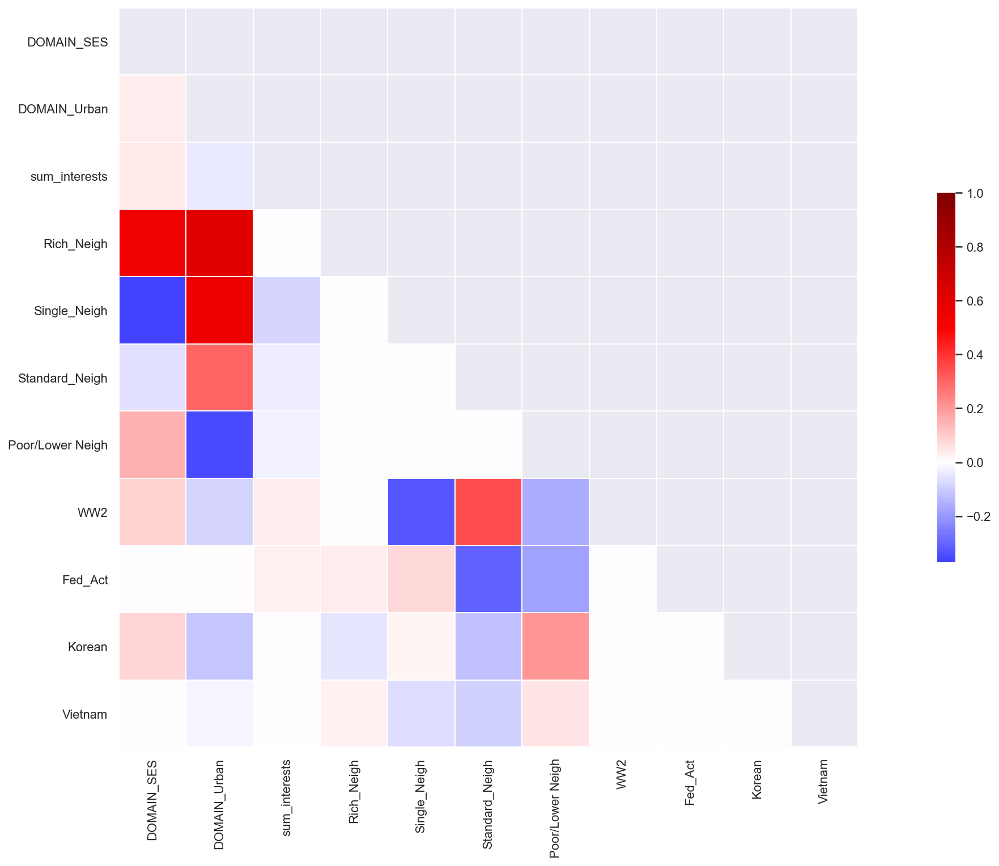

In [99]:
heatmap(selected_df,'pearson')

#### KMEANS

For n_clusters = 2, the average silhouette_score is : 0.26360211185861976
For n_clusters = 3, the average silhouette_score is : 0.1846767025330941
For n_clusters = 4, the average silhouette_score is : 0.18640390551165745
For n_clusters = 5, the average silhouette_score is : 0.19369625542179858
For n_clusters = 6, the average silhouette_score is : 0.18777921939952094
For n_clusters = 7, the average silhouette_score is : 0.176225403179392
For n_clusters = 8, the average silhouette_score is : 0.16138040054555777
For n_clusters = 9, the average silhouette_score is : 0.16016531790378138


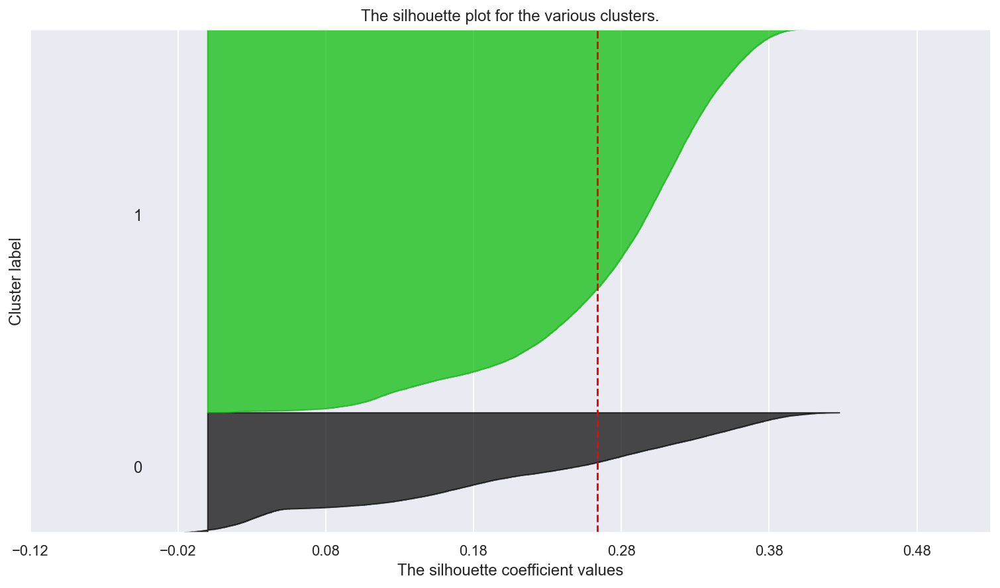

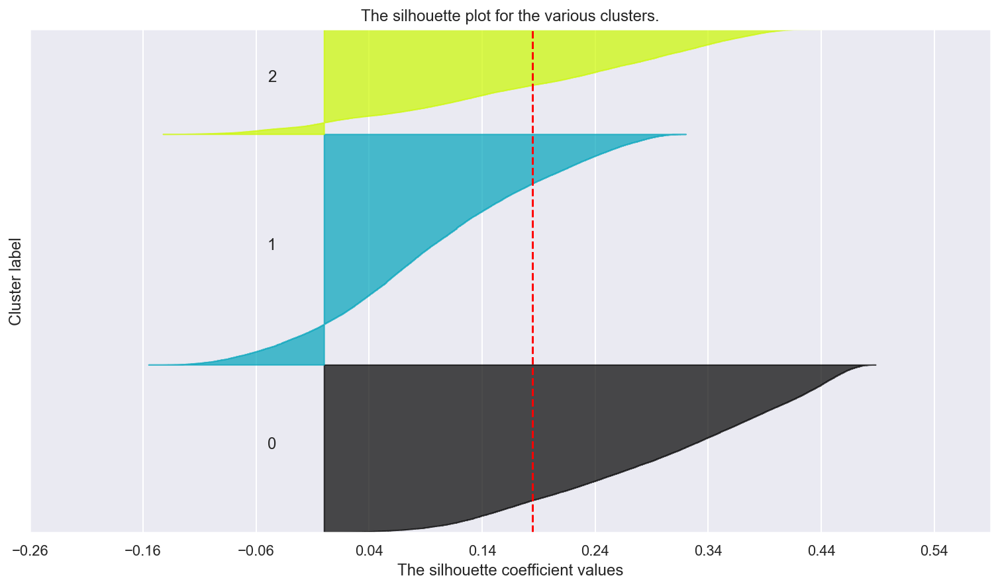

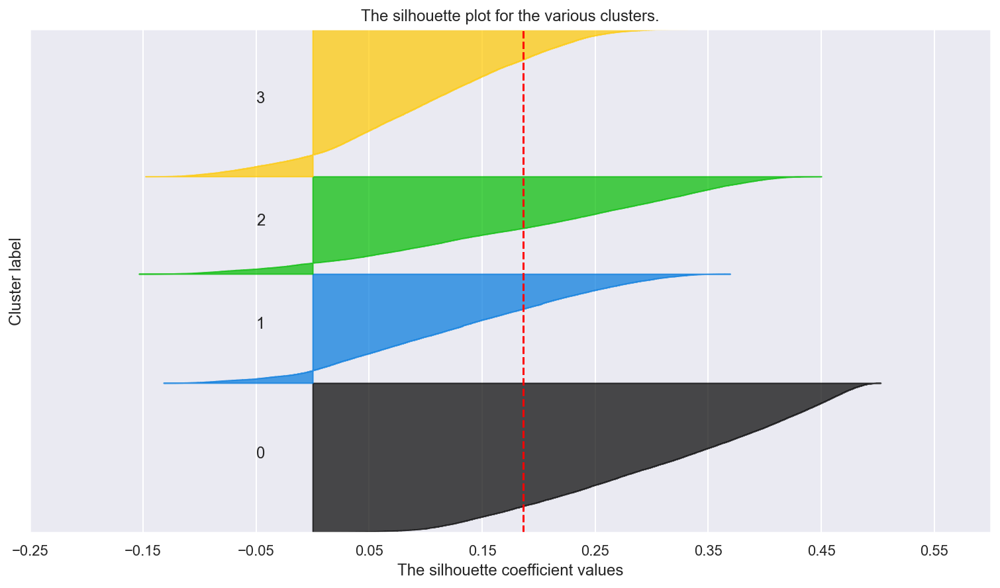

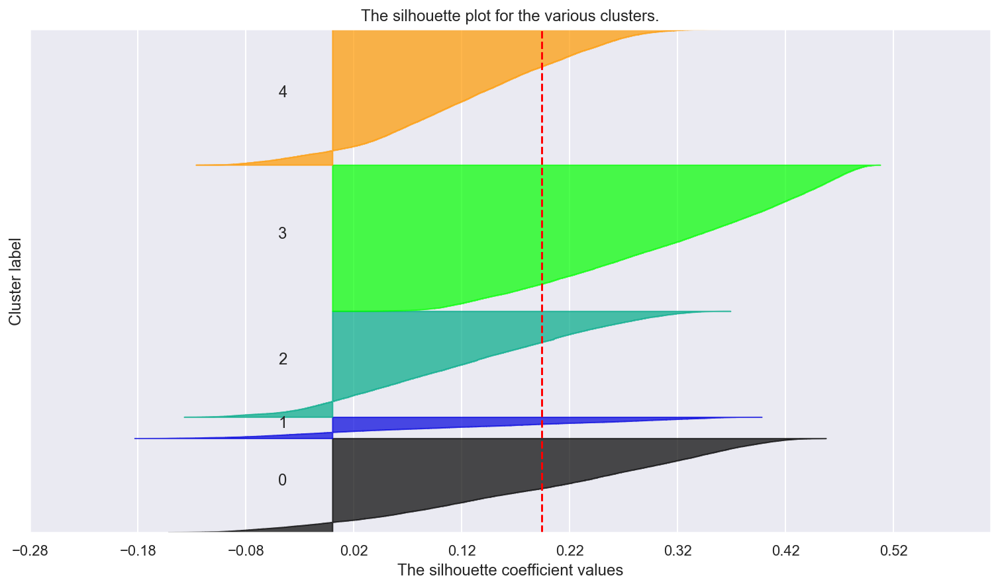

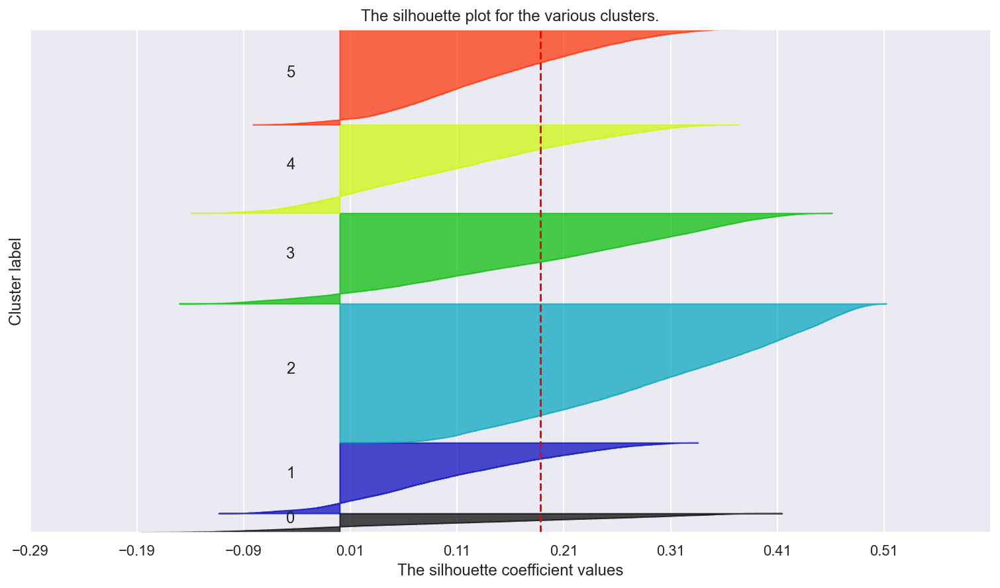

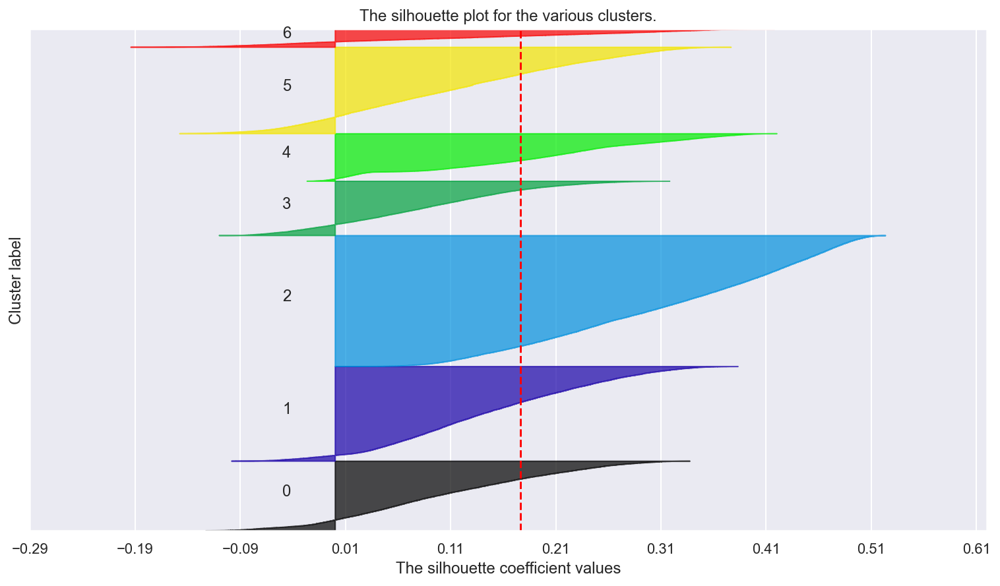

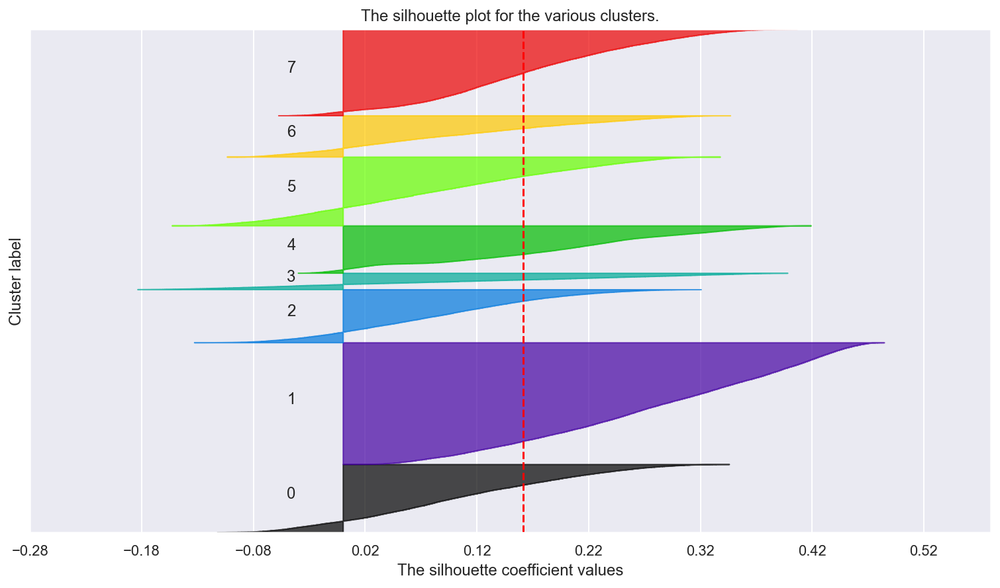

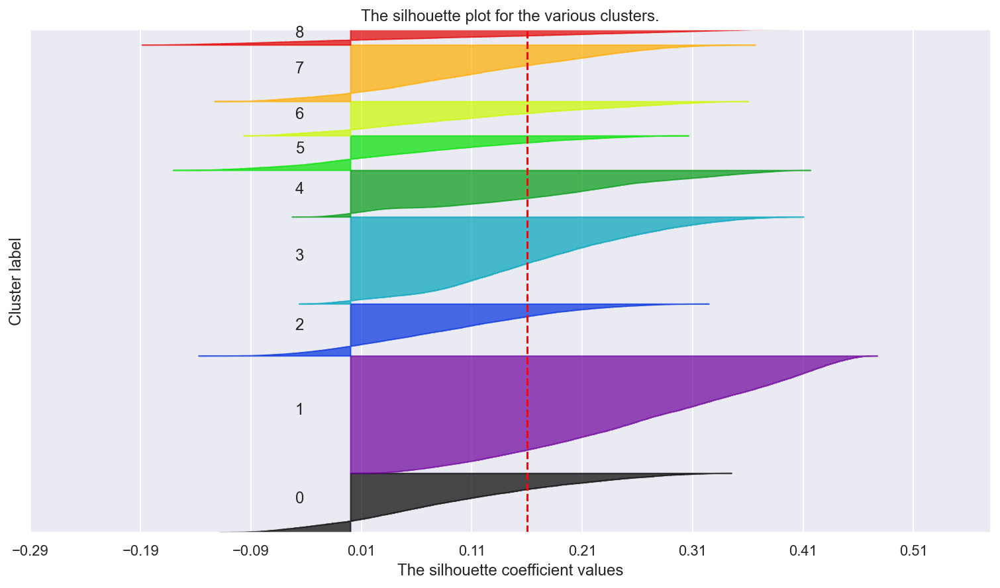

In [101]:
avg_silhouette = []
for nclus in range(1,10):
    # Skip nclus == 1
    if nclus == 1:
        continue
    
    # Create a figure
    fig = plt.figure(figsize=(13, 7))

    # Initialize the KMeans object with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    kmclust = KMeans(n_clusters=nclus, init='k-means++', n_init=15, random_state=1)
    cluster_labels = kmclust.fit_predict(selected_df)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed clusters
    silhouette_avg = silhouette_score(selected_df, cluster_labels)
    avg_silhouette.append(silhouette_avg)
    print(f"For n_clusters = {nclus}, the average silhouette_score is : {silhouette_avg}")

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(selected_df, cluster_labels)

    y_lower = 10
    for i in range(nclus):
        # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
        ith_cluster_silhouette_values.sort()
        
        # Get y_upper to demarcate silhouette y range size
        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i
        
        # Filling the silhouette
        color = cm.nipy_spectral(float(i) / nclus)
        plt.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    plt.title("The silhouette plot for the various clusters.")
    plt.xlabel("The silhouette coefficient values")
    plt.ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    plt.axvline(x=silhouette_avg, color="red", linestyle="--")
    
    # The silhouette coefficient can range from -1, 1
    xmin, xmax = np.round(sample_silhouette_values.min() -0.1, 2), np.round(sample_silhouette_values.max() + 0.1, 2)
    plt.xlim([xmin, xmax])
    
    # The (nclus+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    plt.ylim([0, len(selected_df) + (nclus + 1) * 10])

    plt.yticks([])  # Clear the yaxis labels / ticks
    plt.xticks(np.arange(xmin, xmax, 0.1))

Silhouette refers to a method of interpretation and validation of consistency within clusters of data.

The silhouette value is a measure of how similar an object is to its own cluster (cohesion) compared to other clusters (separation). 

In this picture, it is seen that the best number of clusters would be 2, however, that would lead to a restricted number of clusters that would be so different/heterogeneous(in a inter distance way) and their intra cluster distance would be way to high between each data points that were assigned to that cluster;
That would lead to an increase in variablity  --> thats why we went for 4 clusters

That would lead to a poor segmentation of the donors since a lot of them would be cluster by attributes/neighbourhoods that were false allocate to them(High correlated features would have an insane impact when determining the cluster where the donor belong).

Also, it is important to notice that some clusters got an average silhouette that has a negative values which means that some observations are wrongly assigned to the respective cluster(probably because cluster 2 and 3 are similar in a lot of features)

#### SOM Implementation

By definition SOM are 'Self-organizing maps differ from other artificial neural networks as they apply competitive learning as opposed to error-correction learning (such as backpropagation with gradient descent), and in the sense that they use a neighborhood function to preserve the topological properties of the input space.'

In our analysis, it was decided to explore by detail the census data provided and, therefore, it was initially used PCA to reduce the number of features to cluster associated with donors neighborhood. Following this thought process, PCA actually led us to create and differentiate neighborhoods thanks to the principal components forged.

To try to preserve this clusterization, SOM seemed a good way of keep reducing or, in other words, try to minimize the number of features that can be assign to distinguish each cluster.

'This training utilizes competitive learning. When a training example is fed to the network, its Euclidean distance to all weight vectors is computed. The neuron whose weight vector is most similar to the input is called the best matching unit (BMU).'

In [102]:
# This som implementation does not have a random seed parameter
# We're going to set it up ourselves
np.random.seed(30)

som_interests = sompy.SOMFactory().build(
    selected_df.values, 
    mapsize=(50, 50),
    initialization='random', 
    neighborhood='gaussian',
    training='batch',
    lattice='hexa',
    component_names=selected_df.columns
)
som_interests.train(n_job=-1, verbose='info', train_rough_len=100, train_finetune_len=100)

 Training...
 random_initialization took: 0.003000 seconds
 Rough training...
 radius_ini: 17.000000 , radius_final: 2.833333, trainlen: 100

 epoch: 1 ---> elapsed time:  5.738000, quantization error: 5.569479

 epoch: 2 ---> elapsed time:  5.371000, quantization error: 3.107440

 epoch: 3 ---> elapsed time:  5.615000, quantization error: 3.087433

 epoch: 4 ---> elapsed time:  5.802000, quantization error: 3.078577

 epoch: 5 ---> elapsed time:  5.864000, quantization error: 3.074978

 epoch: 6 ---> elapsed time:  6.328000, quantization error: 3.072918

 epoch: 7 ---> elapsed time:  6.132000, quantization error: 3.071326

 epoch: 8 ---> elapsed time:  4.759000, quantization error: 3.069897

 epoch: 9 ---> elapsed time:  5.422000, quantization error: 3.068660

 epoch: 10 ---> elapsed time:  4.994000, quantization error: 3.067553

 epoch: 11 ---> elapsed time:  4.765000, quantization error: 3.066512

 epoch: 12 ---> elapsed time:  4.766000, quantization error: 3.065499

 epoch: 13 --->

In [103]:
# Coordinates of the units in the input space
som_interests.get_node_vectors()

array([[ 3.09811902,  2.42516943,  1.5381819 , ...,  9.14638816,
        -0.63967518,  1.29091818],
       [ 3.09856836,  2.50726104,  2.21444148, ...,  7.92325183,
        -0.60020555,  0.94309935],
       [ 3.1191142 ,  2.58646413,  3.43411068, ...,  6.66437009,
        -0.47715206,  0.7661667 ],
       ...,
       [ 3.93096224,  3.65474843,  0.81832146, ..., -1.32480121,
        -0.37985   ,  0.01130775],
       [ 3.9301748 ,  3.42902706,  0.8885429 , ..., -1.46542105,
        -0.42125419,  0.03551098],
       [ 3.93264027,  3.33835136,  1.02146921, ..., -1.53368455,
        -0.31553641,  0.27430983]])

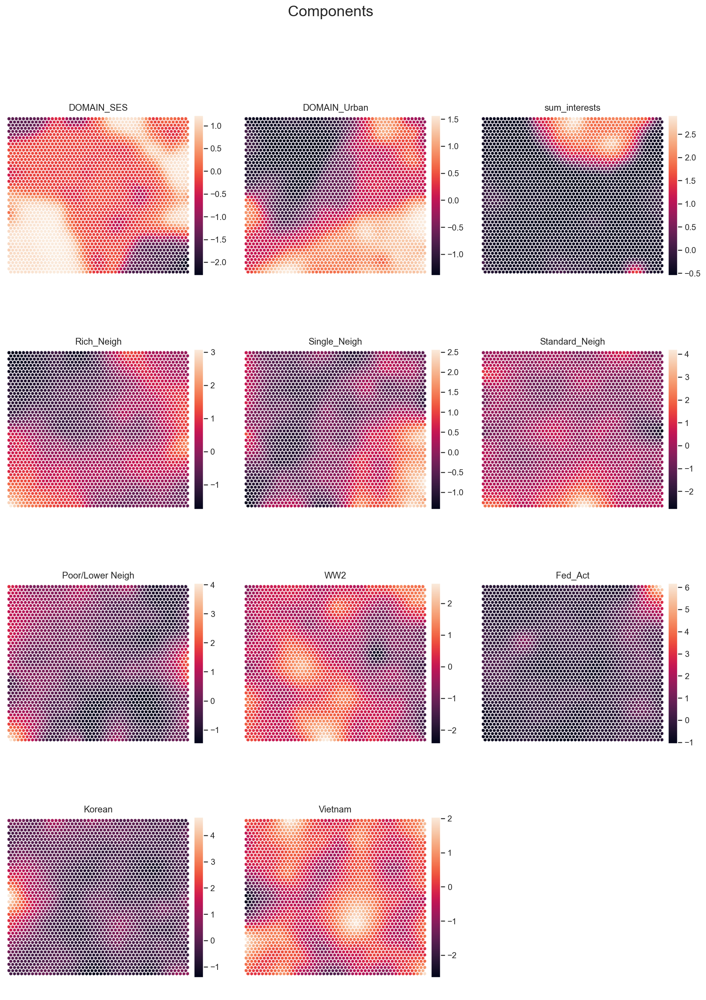

In [104]:
# Component planes on the 50x50 grid
sns.set()
view2D = View2D(12,12,"", text_size=10)
view2D.show(som_interests, col_sz=3, what='codebook')
plt.subplots_adjust(top=0.90)
plt.suptitle("Components", fontsize=20)
plt.show()

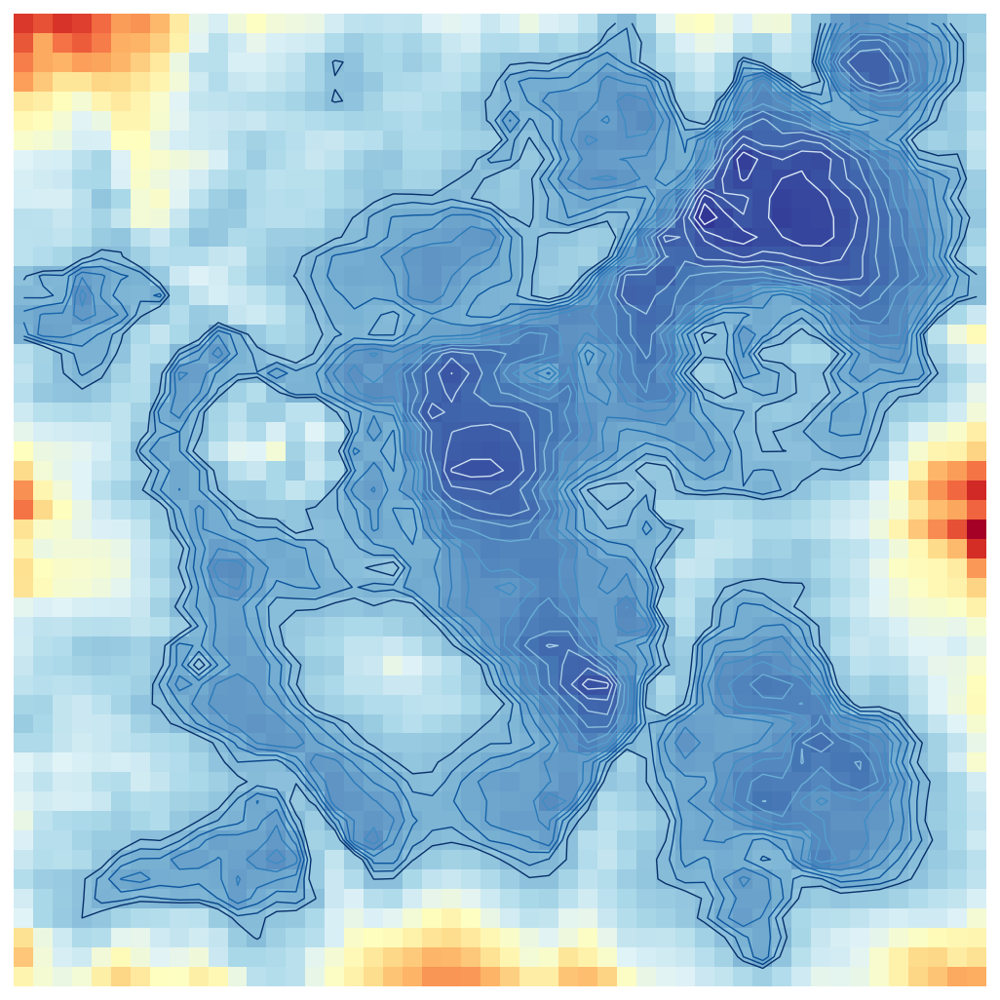

In [105]:
# U-matrix of the 50x50 grid
u = sompy.umatrix.UMatrixView(12, 12, 'umatrix', show_axis=True, text_size=8, show_text=True)

UMAT = u.show(
    som_interests, 
    distance2=1, 
    row_normalized=False, 
    show_data=False, 
    contooor=True 
)

- Darker spaces represented more distant node vectors while light colors are where euclidean distance between each vector is smaller.

- In other words, Light colors are representing spaces where the distances are so small that they can be considered a cluster(where intra-distance is smaller); and darker zones are like barriers between each group of similar vectors

##### Kmeans + SOM

Previously, it was calculated the average silhouette that let us know that probably four or five clusters would be the best choice.

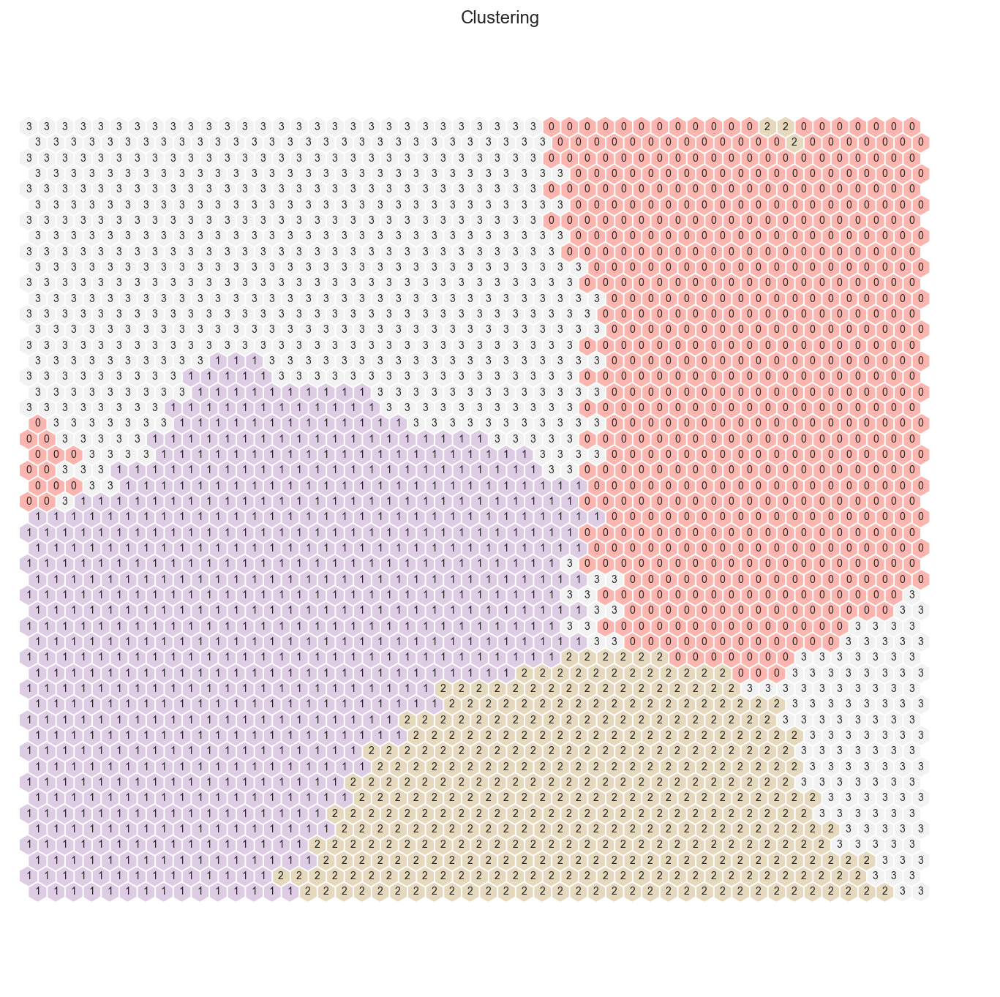

In [106]:
kmeans = KMeans(n_clusters=4, init='k-means++', n_init=18, random_state=50)
nodeclus_labels = som_interests.cluster(kmeans)

hits  = HitMapView(12, 12,"Clustering", text_size=10)
hits.show(som_interests, anotate=True, onlyzeros=False, labelsize=7, cmap="Pastel1")

plt.show()

Those inconsistencies values not very well assigned can be relative to what was talked previously in the silhouette method

It was tried also Hierarchical clustering + SOM, however the best/coherent result was with the combination of Kmeans with SOM

In [107]:
# Perform Hierarchical clustering on top of the 2500 untis (sm.get_node_vectors() output)
#hierclust = AgglomerativeClustering(n_clusters=4, linkage='ward')
#nodeclus_labels = som_interests.cluster(hierclust)

#hits  = HitMapView(12, 12,"Clustering",text_size=10)
#hits.show(som_interests, anotate=True, onlyzeros=False, labelsize=7, cmap="Pastel1")

#plt.show()

In [108]:
nodes = som_interests.get_node_vectors()

df_nodes = pd.DataFrame(nodes, columns=selected_df.columns)
df_nodes['label'] = nodeclus_labels
df_nodes

,DOMAIN_SES,DOMAIN_Urban,sum_interests,Rich_Neigh,Single_Neigh,Standard_Neigh,Poor/Lower Neigh,WW2,Fed_Act,Korean,Vietnam,label
0,3.098119,2.425169,1.538182,0.178149,-0.756992,-0.930912,-0.744850,1.898505,9.146388,-0.639675,1.290918,3
1,3.098568,2.507261,2.214441,0.165808,-0.718672,-0.839547,-0.788973,1.736713,7.923252,-0.600206,0.943099,3
2,3.119114,2.586464,3.434111,0.155553,-0.650230,-0.694572,-0.753626,1.834793,6.664370,-0.477152,0.766167,2
3,3.161295,2.602769,4.572379,0.120460,-0.596134,-0.589690,-0.660130,1.858606,5.417712,-0.296005,0.672610,2
4,3.208947,2.638638,5.435152,0.123551,-0.585924,-0.458407,-0.588566,1.851505,4.257067,-0.090528,0.603094,2
...,...,...,...,...,...,...,...,...,...,...,...,...
2495,3.917301,4.132304,0.691556,3.390339,-0.152923,1.829320,1.793956,0.492999,-1.030373,-0.221422,0.159445,3
2496,3.928625,3.902966,0.772268,3.692825,-0.730763,2.095755,2.180715,0.832719,-1.199761,-0.304973,0.058497,3
2497,3.930962,3.654748,0.818321,4.143510,-1.390893,2.222635,2.669773,1.066871,-1.324801,-0.379850,0.011308,3
2498,3.930175,3.429027,0.888543,4.697380,-1.988672,2.289820,3.235672,1.303627,-1.465421,-0.421254,0.035511,3


In [109]:
# Obtaining SOM's BMUs labels
bmus_map = som_interests.find_bmu(selected_df)[0]  

df_bmus = pd.DataFrame(
    np.concatenate((selected_df, np.expand_dims(bmus_map,1)), axis=1),
    index=selected_df.index, columns=np.append(selected_df.columns,"BMU")
)
df_bmus

,DOMAIN_SES,DOMAIN_Urban,sum_interests,Rich_Neigh,Single_Neigh,Standard_Neigh,Poor/Lower Neigh,WW2,Fed_Act,Korean,Vietnam,BMU
CONTROLN,,,,,,,,,,,,
95515,3.0,2.0,0.0,-1.463731,-0.644142,0.529269,0.030194,0.905518,-0.705231,-0.019173,0.743390,2234.0
148535,4.0,3.0,0.0,2.771247,-1.716517,0.076998,1.581860,-2.286216,-0.459178,0.105255,1.043966,2492.0
15078,3.0,1.0,0.0,-2.353468,-0.722082,-0.052250,0.886842,-1.236227,-0.785203,1.152990,0.447734,1591.0
172556,3.0,1.0,0.0,-1.372858,-0.713307,-0.868914,1.054940,-0.436467,-0.551575,-0.053667,1.894853,1939.0
7112,3.0,3.0,7.0,-1.042552,2.288836,-0.279698,0.700694,0.981471,-0.475387,0.156279,-0.868160,12.0
...,...,...,...,...,...,...,...,...,...,...,...,...
184568,3.0,4.0,0.0,1.732689,0.375044,-0.519483,-1.184765,0.592163,4.278291,-0.142936,-0.440634,502.0
122706,4.0,4.0,0.0,2.909427,-1.507167,0.108960,0.074607,-0.748546,0.591129,-2.090450,-1.439048,2485.0
189641,2.0,4.0,0.0,0.491400,1.830218,-0.771767,-1.103499,-2.220065,-0.043352,2.757464,-2.583425,1448.0


In [110]:
# Get cluster labels for each observation
df_final = df_bmus.merge(df_nodes['label'], 'left', left_on="BMU", right_index=True)

In [111]:
df_final['label'].unique()

array([3, 1, 2, 0])

In [112]:
df_final.drop(columns='BMU').groupby('label').mean()

,DOMAIN_SES,DOMAIN_Urban,sum_interests,Rich_Neigh,Single_Neigh,Standard_Neigh,Poor/Lower Neigh,WW2,Fed_Act,Korean,Vietnam
label,,,,,,,,,,,
0,2.794808,3.778405,0.279843,0.312322,2.124793,-0.296245,0.289113,-1.438922,0.172765,0.099882,-0.187807
1,2.645756,1.013625,0.054357,-2.380740,-0.756964,-0.114862,0.690353,0.188929,-0.378148,0.443690,-0.112354
2,3.121676,2.651700,4.756411,-0.118418,-0.305228,-0.079267,-0.082654,0.111048,0.008356,-0.034813,0.043046
3,3.249443,2.872453,0.121895,0.323144,-0.536993,0.179372,-0.175475,0.469611,-0.012362,-0.089608,0.066736


In [113]:
df_final

,DOMAIN_SES,DOMAIN_Urban,sum_interests,Rich_Neigh,Single_Neigh,Standard_Neigh,Poor/Lower Neigh,WW2,Fed_Act,Korean,Vietnam,BMU,label
CONTROLN,,,,,,,,,,,,,
95515,3.0,2.0,0.0,-1.463731,-0.644142,0.529269,0.030194,0.905518,-0.705231,-0.019173,0.743390,2234.0,3
148535,4.0,3.0,0.0,2.771247,-1.716517,0.076998,1.581860,-2.286216,-0.459178,0.105255,1.043966,2492.0,3
15078,3.0,1.0,0.0,-2.353468,-0.722082,-0.052250,0.886842,-1.236227,-0.785203,1.152990,0.447734,1591.0,1
172556,3.0,1.0,0.0,-1.372858,-0.713307,-0.868914,1.054940,-0.436467,-0.551575,-0.053667,1.894853,1939.0,3
7112,3.0,3.0,7.0,-1.042552,2.288836,-0.279698,0.700694,0.981471,-0.475387,0.156279,-0.868160,12.0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...
184568,3.0,4.0,0.0,1.732689,0.375044,-0.519483,-1.184765,0.592163,4.278291,-0.142936,-0.440634,502.0,3
122706,4.0,4.0,0.0,2.909427,-1.507167,0.108960,0.074607,-0.748546,0.591129,-2.090450,-1.439048,2485.0,3
189641,2.0,4.0,0.0,0.491400,1.830218,-0.771767,-1.103499,-2.220065,-0.043352,2.757464,-2.583425,1448.0,0


In [114]:
# using R^2
def get_ss(df):
    ss = np.sum(df.var() * (df.count() - 1))
    return ss  # return sum of sum of squares of each df variable

sst = get_ss(df_final[selected_df.columns])  # get total sum of squares
ssw_labels = df_final[selected_df.columns.to_list() + ["label"]].groupby(by='label').apply(get_ss)  # compute ssw for each cluster labels
ssb = sst - np.sum(ssw_labels)  
r2 = ssb / sst
r2

0.3033339991387553

In [115]:
labeled_data = df_final.copy()

In [116]:
labeled_data.drop(['BMU'],axis = 1, inplace = True)

In [117]:
labeled_data

,DOMAIN_SES,DOMAIN_Urban,sum_interests,Rich_Neigh,Single_Neigh,Standard_Neigh,Poor/Lower Neigh,WW2,Fed_Act,Korean,Vietnam,label
CONTROLN,,,,,,,,,,,,
95515,3.0,2.0,0.0,-1.463731,-0.644142,0.529269,0.030194,0.905518,-0.705231,-0.019173,0.743390,3
148535,4.0,3.0,0.0,2.771247,-1.716517,0.076998,1.581860,-2.286216,-0.459178,0.105255,1.043966,3
15078,3.0,1.0,0.0,-2.353468,-0.722082,-0.052250,0.886842,-1.236227,-0.785203,1.152990,0.447734,1
172556,3.0,1.0,0.0,-1.372858,-0.713307,-0.868914,1.054940,-0.436467,-0.551575,-0.053667,1.894853,3
7112,3.0,3.0,7.0,-1.042552,2.288836,-0.279698,0.700694,0.981471,-0.475387,0.156279,-0.868160,2
...,...,...,...,...,...,...,...,...,...,...,...,...
184568,3.0,4.0,0.0,1.732689,0.375044,-0.519483,-1.184765,0.592163,4.278291,-0.142936,-0.440634,3
122706,4.0,4.0,0.0,2.909427,-1.507167,0.108960,0.074607,-0.748546,0.591129,-2.090450,-1.439048,3
189641,2.0,4.0,0.0,0.491400,1.830218,-0.771767,-1.103499,-2.220065,-0.043352,2.757464,-2.583425,0


Although, this score is not the highest achieved(there were tried different approaches using more features that would lead to a better score), it was decided that these selected features would have been the best ones to describe a possible neighborhood/donor for a business/marketing perspective since it's more reliable/easy to connect with these type of people for a PVA campaign 

## Profiling Report

In [118]:
from pandas_profiling import ProfileReport
profile = ProfileReport(
    labeled_data, 
    title='PVA Donors',
    correlations={
        "pearson": {"calculate": True},
        "spearman": {"calculate": False},
        "kendall": {"calculate": False},
        "phi_k": {"calculate": False},
        "cramers": {"calculate": False},
    },
)

profile.to_notebook_iframe()

- After watching some analysis from Profiling Report, it is possible to observe that almost every numerical feature has a Normal ou skewed Normal Distribution; 

- Other conclusion is the a larger absolute frequency of donors that dont have interests is quite significatly


### Visualization of the absolute frequency in each cluster

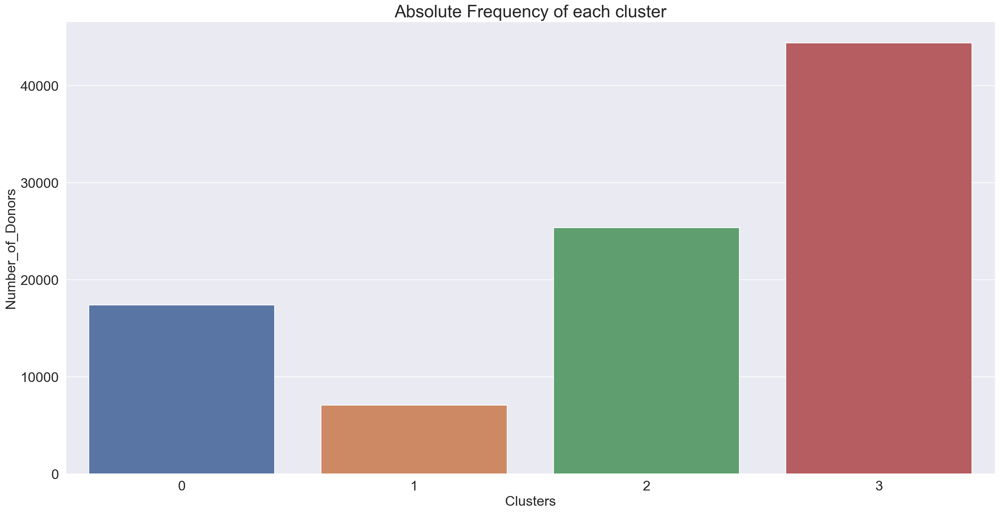

In [199]:
number_of_donors = labeled_data.groupby(by='label', as_index=False).count().iloc[:,[0,1]]

#in other to make it more cohesive, the name of the second column should be relative to the number of obs

number_of_donors.rename({'DOMAIN_SES':'Number_of_Donors'}, axis = 1, inplace = True)

#Plotting barplot for better visualization of each cluster
ax = sns.barplot(x='label', y="Number_of_Donors", data=number_of_donors)
plt.xlabel('Clusters', fontsize = 20)
plt.xticks(fontsize=20)
plt.ylabel("Number_of_Donors", fontsize = 20)
plt.yticks(fontsize=20)
plt.title("Absolute Frequency of each cluster", fontsize = 25)
plt.show()

In [120]:
print('label 0: ',len(labeled_data[(labeled_data.label == 0)]))
print('----------------------------------')
print('label 1: ',len(labeled_data[(labeled_data.label == 1)]))
print('----------------------------------')
print('label 2: ',len(labeled_data[(labeled_data.label == 2)]))
print('----------------------------------')
print('label 3: ',len(labeled_data[(labeled_data.label == 3)]))

label 0:  17374
----------------------------------
label 1:  7046
----------------------------------
label 2:  25346
----------------------------------
label 3:  44407


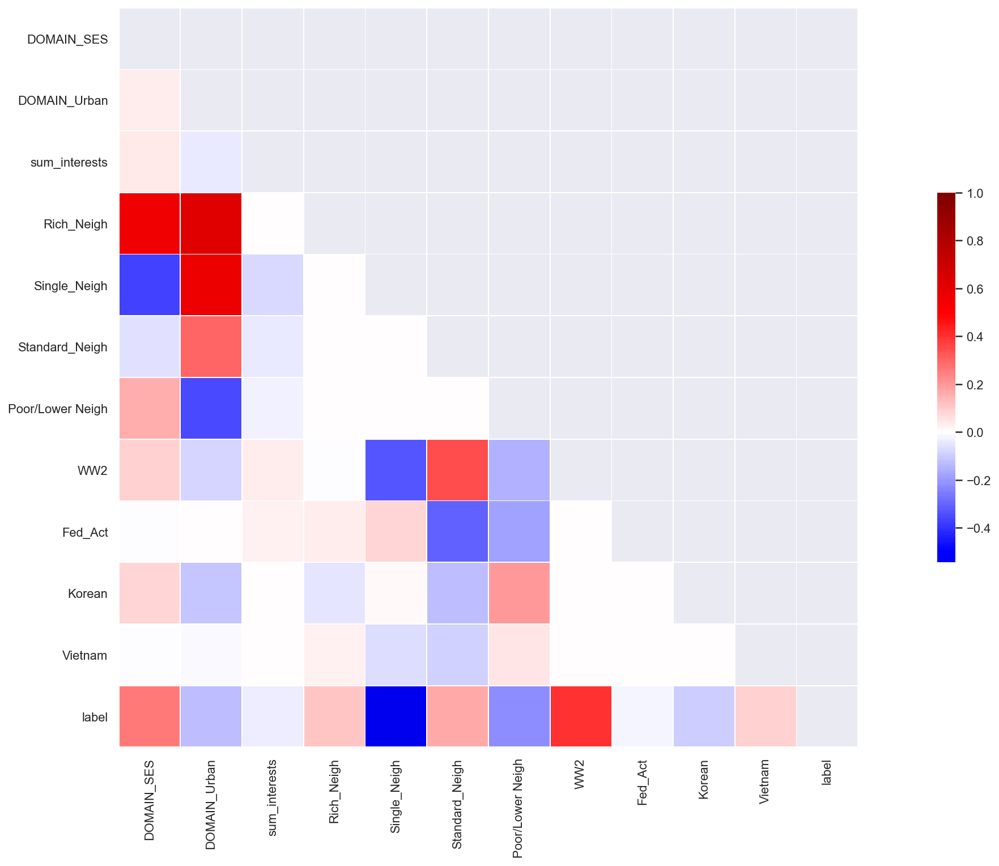

In [121]:
heatmap(labeled_data, 'pearson')

Conclusions:
- Cluster 0 and 1: more relative to Instable SES which can possible be relative with their number of donations being lower in comparison to label 2/3 , since their social economic status is not the best; Both respective donors from those cluster belong/live where are a lot more single people that can lead to being more poor and veterans being from not so prestigious war(or that led to some possible higher number of widows like Korean Vets); However they differentiate themselves especially on the locations of each cluster that it's going to be analyse in the end of the study
- Cluster 2 and 3: Donors belonging to these clusters should be the ones being targeted first since they have a better SES and living in richer neighborhoods while veterans living there are usually from Vietnam and WW2 wars(which are the most famous american wars that could lead to a better compensation); Besides that, there are a reasonable correlation with standard neighborhoods which mean that possibly, there are in the neighborhood people that are actively working for the Government or for the Military(that would possible be more interested in this type of donations --> more conection to the cause)

#### Representation in a lower dimensional space using TSNE

According to sklearn TSNE documentation, where it's possible to read some recommendationsm like:

- Highly recommended to use another dimensionality reduction method (e.g. PCA for dense data or TruncatedSVD for sparse data) to reduce the number of dimensions to a reasonable amount (e.g. 50) if the number of features is very high;
- This will suppress some noise and speed up the computation of pairwise distances between samples.");


It was decided to use TSNE since all requirements were filled thans to some clustering/dimensionality reduction techniques previously used.

In [122]:
two_dim = TSNE(random_state=42, perplexity = 40).fit_transform(labeled_data)

In [123]:
labels = labeled_data['label'].unique()

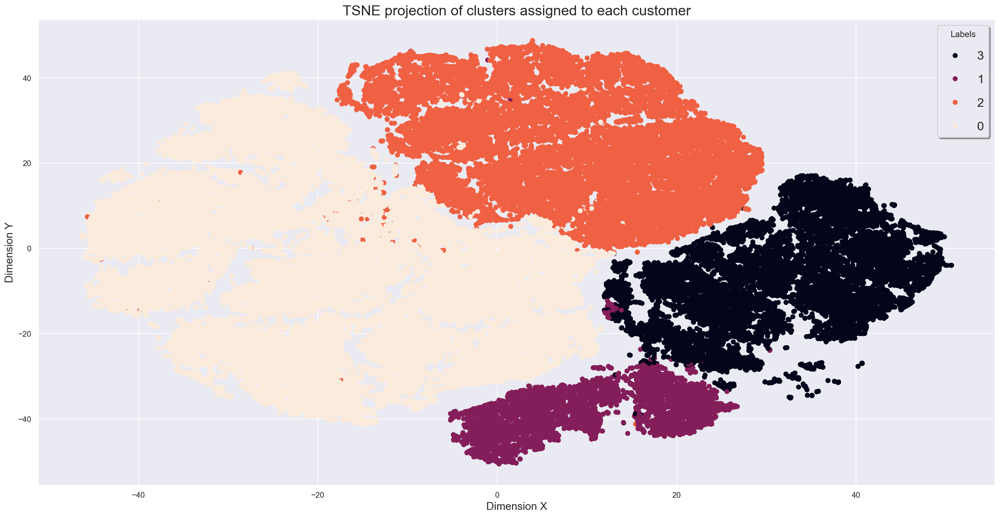

In [124]:
tsne = plt.scatter(two_dim[:,0], two_dim[:,1], c=labeled_data['label'])
handles, _ = tsne.legend_elements(prop='colors')
plt.legend(handles, labels,scatterpoints=1,labelspacing=1, title='Labels', shadow=True, fontsize='xx-large')
plt.title('TSNE projection of clusters assigned to each customer',fontsize = 20)
plt.xlabel('Dimension X',fontsize=15)
plt.ylabel('Dimension Y',fontsize = 15)

plt.show()

### Decision Tree Classifier

Using Decision Tree to check if our clustering model/techniques would have a good performance in a classification scenary

- Firstly, separate dependent variable from all other features;
- Secondly, train the data using sklearn train test split;
- Finally, fitting the model and getting the prediction.

In [125]:
#first step
y = labeled_data[['label']]
X = labeled_data.drop('label',axis=1)


# second step
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=42
)

# final step
clf = DecisionTreeClassifier(random_state=42, max_depth=3)
clf.fit(X_train, y_train)
print("It is estimated that in average, it was able to predict {0:.2f}% of the customers' label based on previously clustering".format(clf.score(X_test, y_test)*100))

It is estimated that in average, it was able to predict 84.67% of the customers' label based on previously clustering


#### Decision Tree Visualization

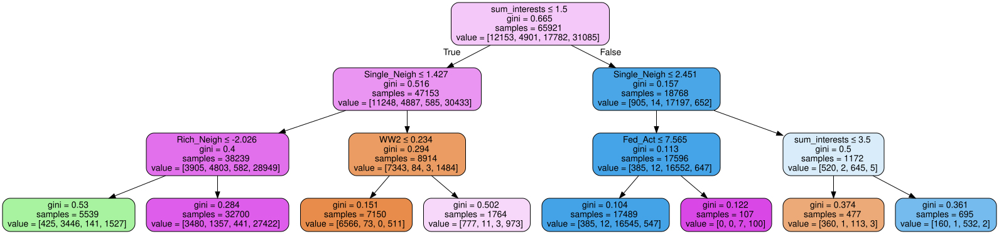

In [126]:
# Visualizing the decision tree
dot_data = export_graphviz(clf, out_file=None, 
                           feature_names=X.columns.to_list(),
                           filled=True,
                           rounded=True,
                           special_characters=True)  
from sklearn import tree
graphviz.Source(dot_data)


## Defining a financial/marketing strategy to target donors

### RFA

RFA or RFM stands for Recency, Frequency, and Amount/Monetary value, each corresponding to some key customer trait. These RFM metrics are important indicators of a customer’s behavior because frequency and monetary value affects a customer’s lifetime value, and recency affects retention, a measure of engagement.

Since the objective of this study, is to find out clusters that are associated with all lapsed donors, it was decided that one approach to deal with RFA would be to try to search for patterns from the historical behaviour of all donors in this dataset.

Finally, this will be used as a possible marketing approach to define the best strategy to take back lapsed/inactive donors

In [127]:
data_rfa = data[[col for col in data if col.startswith('RFA')]]

In [128]:
#Recency to check out the behaviour of each donor and 
#possibly what was the type of promotion that led to a lapsed donor to become an active donor
for i in range(2,25):
    data['RFA_'+str(i)+'R'] = data['RFA_'+ str(i)].str.split('',expand=True)[1]

- Behaviours that we are looking for : L --> S; L--> A; I--> S; I --> A

In [129]:
data_rfa_r = data.iloc[:,-23:]

In [130]:
data_rfa_r[data_rfa_r['RFA_17R'].astype(str).str.contains('P')]

,RFA_2R,RFA_3R,RFA_4R,RFA_5R,RFA_6R,RFA_7R,RFA_8R,RFA_9R,RFA_10R,RFA_11R,...,RFA_15R,RFA_16R,RFA_17R,RFA_18R,RFA_19R,RFA_20R,RFA_21R,RFA_22R,RFA_23R,RFA_24R
CONTROLN,,,,,,,,,,,,,,,,,,,,,
15419,L,A,A,A,N,N,N,N,N,N,...,,,P,P,,,,,,
178309,L,A,A,,N,N,N,N,F,F,...,,,P,P,,,,,,
118016,L,A,A,,N,N,N,N,F,F,...,,,P,P,,,,,,
108888,L,A,A,A,N,N,N,N,N,N,...,N,,P,P,,,,,,
56803,L,N,N,,N,F,F,F,F,F,...,,,P,P,,,,,,
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
170118,L,A,A,,N,N,N,N,N,N,...,,,P,P,,,,,,
56972,L,A,A,A,N,N,N,N,N,N,...,,,P,P,,,,,,
139193,L,A,A,,N,N,N,N,F,F,...,,,P,P,,,,,,


- After some exploration, we notice that Letter P tends to identify the first time someone who has not donated yet but eventually will/First time he/she donated --> F
- So, it was decided to replace P for F , to avoid inconsistencies

In [131]:
data_rfa_r.replace(' ', np.nan, inplace = True)

- In order to get this method as accurate as possible, it was decided to use bfill method so promotions would be cronologically accurate. 

In [132]:
data_rfa_r.T.fillna(method='bfill',inplace=True)

In [133]:
rfa = data_rfa_r.T

In [134]:
rfa.fillna(method='bfill',inplace=True)

In [135]:
#people that until that moment where not donors but eventually, they'll be.
rfa.replace(np.nan, 'P', inplace = True)

In [136]:
rfa.fillna(method='bfill',inplace=True)

In [137]:
#reversing again to normal format
rfa_r = rfa.T

In [138]:
rfa_r

,RFA_2R,RFA_3R,RFA_4R,RFA_5R,RFA_6R,RFA_7R,RFA_8R,RFA_9R,RFA_10R,RFA_11R,...,RFA_15R,RFA_16R,RFA_17R,RFA_18R,RFA_19R,RFA_20R,RFA_21R,RFA_22R,RFA_23R,RFA_24R
CONTROLN,,,,,,,,,,,,,,,,,,,,,
95515,L,S,S,S,S,S,S,S,S,S,...,S,S,S,S,S,S,S,S,S,S
148535,L,A,A,A,A,A,A,A,A,A,...,L,L,N,N,N,N,N,N,F,F
15078,L,S,S,S,S,S,S,S,S,S,...,S,S,S,S,S,S,S,S,S,S
172556,L,S,S,S,S,S,S,S,S,S,...,S,S,S,S,A,A,A,A,P,P
7112,L,A,A,A,A,I,A,A,L,A,...,L,L,A,A,A,A,A,I,A,A
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
184568,L,F,F,F,F,P,P,P,P,P,...,P,P,P,P,P,P,P,P,P,P
122706,L,P,P,P,P,P,P,P,P,P,...,P,P,P,P,P,P,P,P,P,P
189641,L,S,S,S,S,A,A,N,N,N,...,N,F,F,F,P,P,P,P,P,P


- The first column will be dropped for the sake of this type of analysis where the most recent promo doesnt have any influence in the history/behaviour of the donor(--> for last promotion, they are all lapsed donors)


In [139]:
rfa_r.drop('RFA_2R',axis = 1,inplace = True)

In [140]:
hey = rfa_r.copy()

### Promotions importance to turn a lapsed/inactive into active/star

In [141]:
#grouping  columns, so we can have the respect order of events/state of donor

promo_al = ['AL']
promo_sl = ['SL']
promo_ai = ['AI']
promo_si = ['SI']


matched_al = (hey.shift(axis = 1) + hey).isin(promo_al)
matched_sl = (hey.shift(axis = 1) + hey).isin(promo_sl)
matched_ai = (hey.shift(axis = 1) + hey).isin(promo_ai)
matched_si = (hey.shift(axis = 1) + hey).isin(promo_si)

In [142]:
hhhh= (hey.shift(axis = 1) + hey)
hhhh

,RFA_3R,RFA_4R,RFA_5R,RFA_6R,RFA_7R,RFA_8R,RFA_9R,RFA_10R,RFA_11R,RFA_12R,...,RFA_15R,RFA_16R,RFA_17R,RFA_18R,RFA_19R,RFA_20R,RFA_21R,RFA_22R,RFA_23R,RFA_24R
CONTROLN,,,,,,,,,,,,,,,,,,,,,
95515,NaN,SS,SS,SS,SS,SS,SS,SS,SS,SS,...,SS,SS,SS,SS,SS,SS,SS,SS,SS,SS
148535,NaN,AA,AA,AA,AA,AA,AA,AA,AA,AA,...,LL,LL,LN,NN,NN,NN,NN,NN,NF,FF
15078,NaN,SS,SS,SS,SS,SS,SS,SS,SS,SS,...,SS,SS,SS,SS,SS,SS,SS,SS,SS,SS
172556,NaN,SS,SS,SS,SS,SS,SS,SS,SS,SS,...,SS,SS,SS,SS,SA,AA,AA,AA,AP,PP
7112,NaN,AA,AA,AA,AI,IA,AA,AL,LA,AA,...,LL,LL,LA,AA,AA,AA,AA,AI,IA,AA
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
184568,NaN,FF,FF,FF,FP,PP,PP,PP,PP,PP,...,PP,PP,PP,PP,PP,PP,PP,PP,PP,PP
122706,NaN,PP,PP,PP,PP,PP,PP,PP,PP,PP,...,PP,PP,PP,PP,PP,PP,PP,PP,PP,PP
189641,NaN,SS,SS,SS,SA,AA,AN,NN,NN,NN,...,NN,NF,FF,FF,FP,PP,PP,PP,PP,PP


In [143]:
AL = matched_al.columns[(matched_al == True).any()].tolist()
SL = matched_sl.columns[(matched_sl == True).any()].tolist()
AI = matched_ai.columns[(matched_ai == True).any()].tolist()
SI = matched_si.columns[(matched_si == True).any()].tolist()

In [144]:
#excluding index that dont have the same characteristics
index_al = matched_al[(matched_al == True).any(axis = 1)].index.to_list()
index_sl = matched_sl[(matched_sl == True).any(axis = 1)].index.to_list()
index_ai = matched_ai[(matched_ai == True).any(axis = 1)].index.to_list()
index_si = matched_si[(matched_si == True).any(axis = 1)].index.to_list()
index_list_to_exclude = []
index_list_to_exclude.extend(index_al)
index_list_to_exclude.extend(index_sl)
index_list_to_exclude.extend(index_ai)
index_list_to_exclude.extend(index_si)
len(index_list_to_exclude) 

29028

In [145]:
not_LI = hhhh[~hhhh.index.isin(index_list_to_exclude)]

In [146]:
print('Lapsed --> Active: ',len(matched_al[(matched_al == True).any(axis = 1)]))
print('Lapsed --> Star: ', len(matched_sl[(matched_sl == True).any(axis = 1)]))
print('Inactive --> Active: ',len(matched_ai[(matched_ai == True).any(axis = 1)]))
print('Inactive --> Star: ',len(matched_si[(matched_si == True).any(axis = 1)]))
print('Never went Lapsed or Inactive: ',len(not_LI))
print('DATA: ',len(matched_al[(matched_al == True).any(axis = 1)]) + len(matched_sl[(matched_sl == True).any(axis = 1)]) + len(matched_ai[(matched_ai == True).any(axis = 1)]) + len(not_LI))

Lapsed --> Active:  22953
Lapsed --> Star:  691
Inactive --> Active:  5074
Inactive --> Star:  310
Never went Lapsed or Inactive:  65627
DATA:  94345


#### Counting / Impact of Promotions in donor behaviour

In [147]:
#Lapsed --> Active(Promotions Effect counting)
matched_al[(matched_al == True).any(axis = 1)].sum()

RFA_3R        0
RFA_4R       11
RFA_5R     2070
RFA_6R     2638
RFA_7R     3839
RFA_8R        9
RFA_9R     1999
RFA_10R     629
RFA_11R      58
RFA_12R       5
RFA_13R    2614
RFA_14R    1574
RFA_15R    2253
RFA_16R     238
RFA_17R    3293
RFA_18R      15
RFA_19R    1286
RFA_20R     636
RFA_21R       2
RFA_22R       1
RFA_23R     507
RFA_24R     525
dtype: int64

In [148]:
matched_sl[(matched_sl == True).any(axis = 1)].sum()

RFA_3R       0
RFA_4R       1
RFA_5R      41
RFA_6R      67
RFA_7R     115
RFA_8R       0
RFA_9R      16
RFA_10R     41
RFA_11R      4
RFA_12R      1
RFA_13R    115
RFA_14R      3
RFA_15R     92
RFA_16R     22
RFA_17R    116
RFA_18R      0
RFA_19R     19
RFA_20R     12
RFA_21R      3
RFA_22R      0
RFA_23R     30
RFA_24R      8
dtype: int64

In [149]:
matched_ai[(matched_ai == True).any(axis = 1)].sum()

RFA_3R       0
RFA_4R       3
RFA_5R     433
RFA_6R     500
RFA_7R     625
RFA_8R       3
RFA_9R     402
RFA_10R    134
RFA_11R      9
RFA_12R      2
RFA_13R    492
RFA_14R    542
RFA_15R    875
RFA_16R    121
RFA_17R    535
RFA_18R      5
RFA_19R    123
RFA_20R     89
RFA_21R      2
RFA_22R    313
RFA_23R      0
RFA_24R      0
dtype: int64

In [150]:
matched_si[(matched_si == True).any(axis = 1)].sum()

RFA_3R       0
RFA_4R       0
RFA_5R       3
RFA_6R      16
RFA_7R      11
RFA_8R       0
RFA_9R       1
RFA_10R     15
RFA_11R      0
RFA_12R      0
RFA_13R     16
RFA_14R      0
RFA_15R     42
RFA_16R     12
RFA_17R      9
RFA_18R      0
RFA_19R      1
RFA_20R     42
RFA_21R      0
RFA_22R    148
RFA_23R      0
RFA_24R      0
dtype: int64

In [151]:
print('--------------------Lapsed-------------------------')
#if we dont considerate difference between S and A (since we just want to turn) for Lapsed donors
lapsed_active = matched_sl[(matched_sl == True).any(axis = 1)].sum() + matched_al[(matched_al == True).any(axis = 1)].sum()
print(lapsed_active)
print('--------------------Inactive-------------------------')
#if we dont considerate difference between S and A (since we just want to turn) for Inactive donors
inactive_active = matched_ai[(matched_ai == True).any(axis = 1)].sum() + matched_si[(matched_si == True).any(axis = 1)].sum()
print(inactive_active)

--------------------Lapsed-------------------------
RFA_3R        0
RFA_4R       12
RFA_5R     2111
RFA_6R     2705
RFA_7R     3954
RFA_8R        9
RFA_9R     2015
RFA_10R     670
RFA_11R      62
RFA_12R       6
RFA_13R    2729
RFA_14R    1577
RFA_15R    2345
RFA_16R     260
RFA_17R    3409
RFA_18R      15
RFA_19R    1305
RFA_20R     648
RFA_21R       5
RFA_22R       1
RFA_23R     537
RFA_24R     533
dtype: int64
--------------------Inactive-------------------------
RFA_3R       0
RFA_4R       3
RFA_5R     436
RFA_6R     516
RFA_7R     636
RFA_8R       3
RFA_9R     403
RFA_10R    149
RFA_11R      9
RFA_12R      2
RFA_13R    508
RFA_14R    542
RFA_15R    917
RFA_16R    133
RFA_17R    544
RFA_18R      5
RFA_19R    124
RFA_20R    131
RFA_21R      2
RFA_22R    461
RFA_23R      0
RFA_24R      0
dtype: int64


In [152]:
lapsed_active = lapsed_active.to_frame()
inactive_active = inactive_active.to_frame()

In [153]:
lapsed_active.columns = ['Lapsed']
inactive_active.columns = ['Inactive']

In [154]:
lap_plus_ina = pd.concat([lapsed_active,inactive_active],axis = 1)

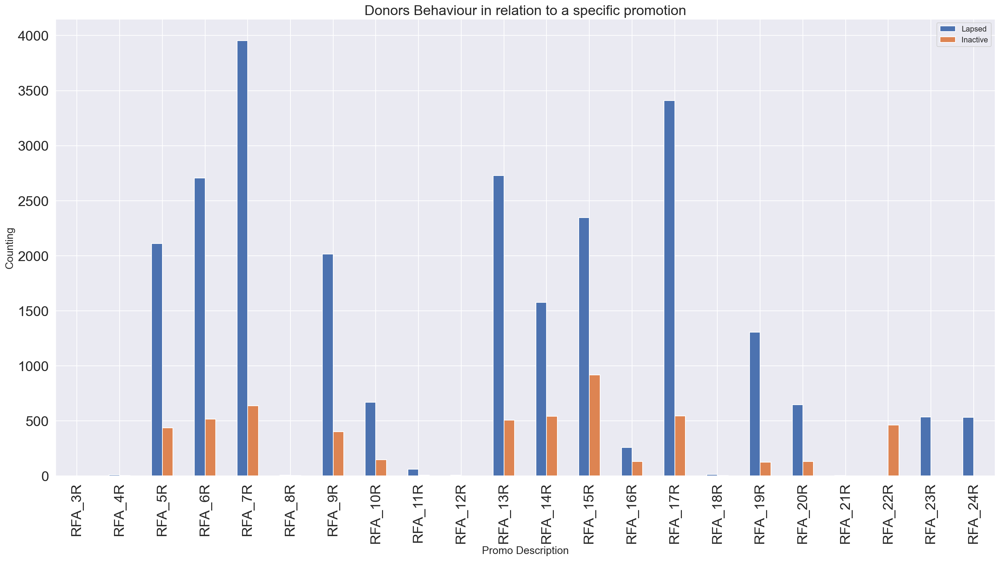

In [200]:
sns.set()

# plot data
ax = lap_plus_ina.plot.bar()
ax.set_xlabel("Promo Description",fontsize = 15)
plt.xticks(fontsize=20)
ax.set_ylabel("Counting",fontsize = 15)
plt.yticks(fontsize=20)
ax.set_title("Donors Behaviour in relation to a specific promotion",fontsize = 20)

plt.subplots_adjust(wspace=0.3)


plt.show()

#### Specified by each cluster:

In [156]:
label_V0 = labeled_data[(labeled_data.label == 0)]
label_V1 = labeled_data[(labeled_data.label == 1)]
label_V2 = labeled_data[(labeled_data.label == 2)]
label_V3 = labeled_data[(labeled_data.label == 3)]

In [159]:
label_v0 = pd.merge(label_V0, hhhh, left_index=True, right_index=True)
label_v0.drop(labeled_data.columns,axis = 1,inplace = True)
label_v1 = pd.merge(label_V1, hhhh, left_index=True, right_index=True)
label_v1.drop(labeled_data.columns,axis = 1,inplace = True)
label_v2 = pd.merge(label_V2, hhhh, left_index=True, right_index=True)
label_v2.drop(labeled_data.columns,axis = 1,inplace = True)
label_v3 = pd.merge(label_V3, hhhh, left_index=True, right_index=True)
label_v3.drop(labeled_data.columns,axis = 1,inplace = True)

In [160]:
label_v0.isin(promo_al)

,RFA_3R,RFA_4R,RFA_5R,RFA_6R,RFA_7R,RFA_8R,RFA_9R,RFA_10R,RFA_11R,RFA_12R,...,RFA_15R,RFA_16R,RFA_17R,RFA_18R,RFA_19R,RFA_20R,RFA_21R,RFA_22R,RFA_23R,RFA_24R
CONTROLN,,,,,,,,,,,,,,,,,,,,,
60127,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
97870,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
37810,False,False,False,False,False,False,False,False,False,False,...,False,False,True,False,False,False,False,False,False,False
84035,False,False,False,False,False,False,False,False,False,False,...,False,False,True,False,False,False,False,False,False,False
82335,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
57442,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
22658,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
12322,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


#### Cluster 0

##### Lapsed to Active

<AxesSubplot:>

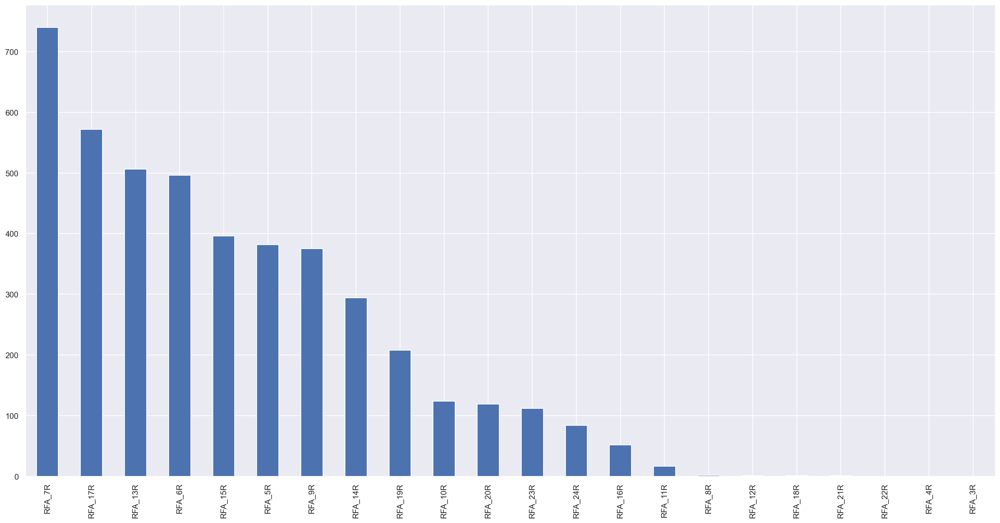

In [161]:
(label_v0.isin(promo_al)[(label_v0.isin(promo_al)== True).any(axis = 1)].sum() + label_v0.isin(promo_sl)[(label_v0.isin(promo_sl)== True).any(axis = 1)].sum()).sort_values(ascending = False).plot.bar()

- Promos : 7/17/13/8

##### Inactive to Active

<AxesSubplot:>

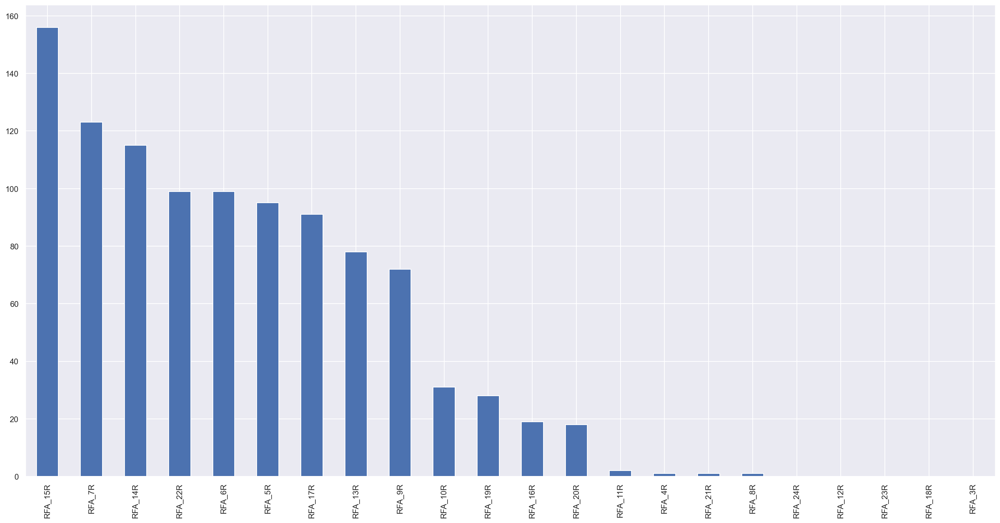

In [162]:
(label_v0.isin(promo_ai)[(label_v0.isin(promo_ai)== True).any(axis = 1)].sum() + label_v0.isin(promo_si)[(label_v0.isin(promo_si)== True).any(axis = 1)].sum()).sort_values(ascending = False).plot.bar()

- Promos: 15/7/14/22

#### Cluster 1

<AxesSubplot:>

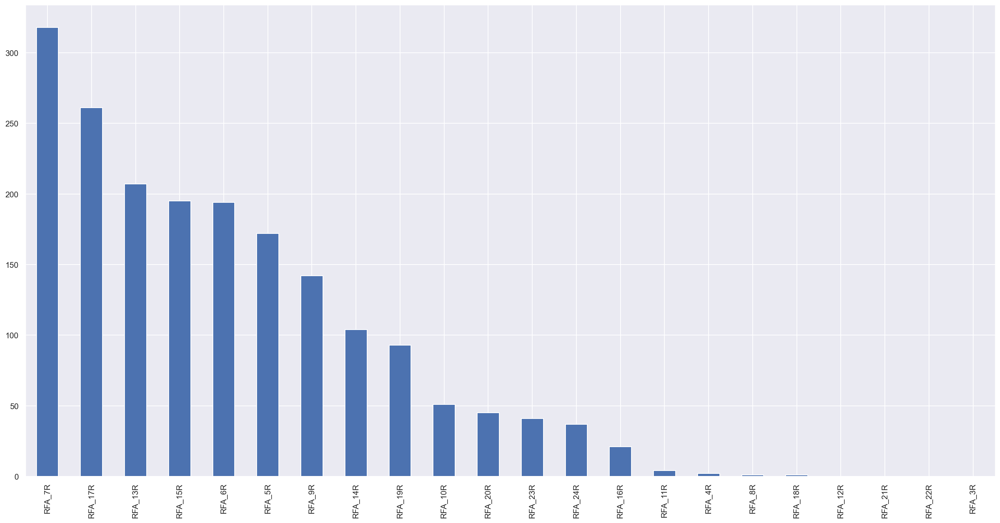

In [163]:
(label_v1.isin(promo_al)[(label_v1.isin(promo_al)== True).any(axis = 1)].sum() + label_v1.isin(promo_sl)[(label_v1.isin(promo_sl)== True).any(axis = 1)].sum()).sort_values(ascending = False).plot.bar()

- Promos: 7/17/13/15/6

<AxesSubplot:>

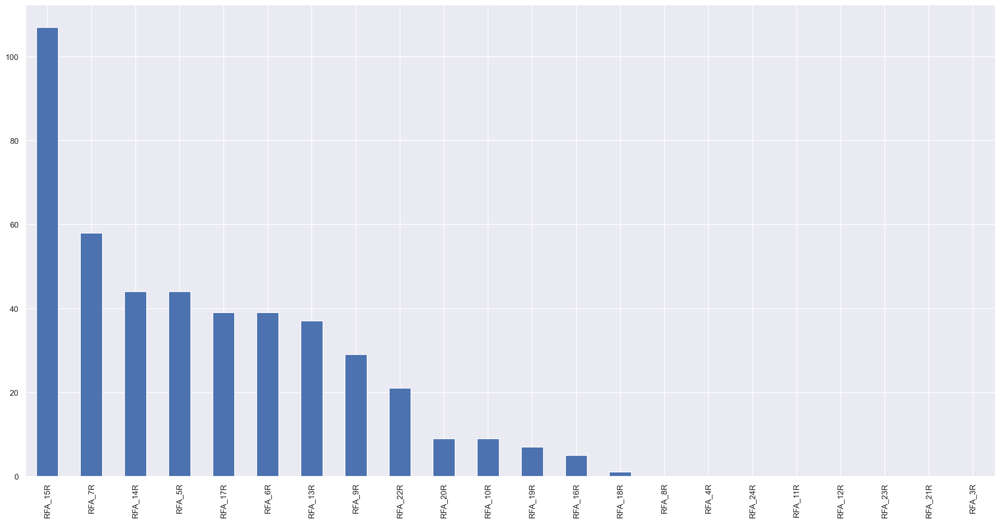

In [164]:
(label_v1.isin(promo_ai)[(label_v1.isin(promo_ai)== True).any(axis = 1)].sum() + label_v1.isin(promo_si)[(label_v1.isin(promo_si)== True).any(axis = 1)].sum()).sort_values(ascending = False).plot.bar()

- Promos: 15(by far)/ 7/ 14/ 5

#### Cluster 2

<AxesSubplot:>

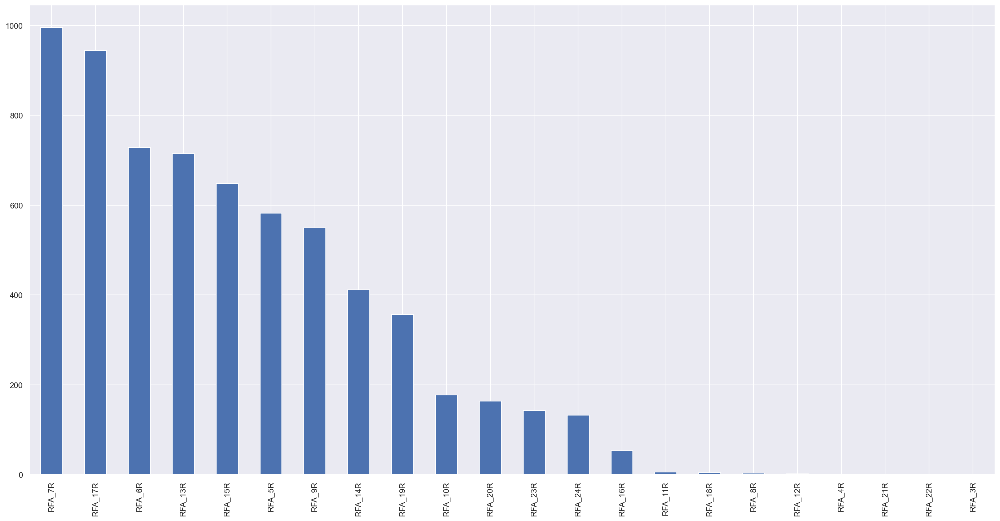

In [165]:
(label_v2.isin(promo_al)[(label_v2.isin(promo_al)== True).any(axis = 1)].sum() + label_v2.isin(promo_sl)[(label_v2.isin(promo_sl)== True).any(axis = 1)].sum()).sort_values(ascending = False).plot.bar()

- Promos:7/17/6/13/15

<AxesSubplot:>

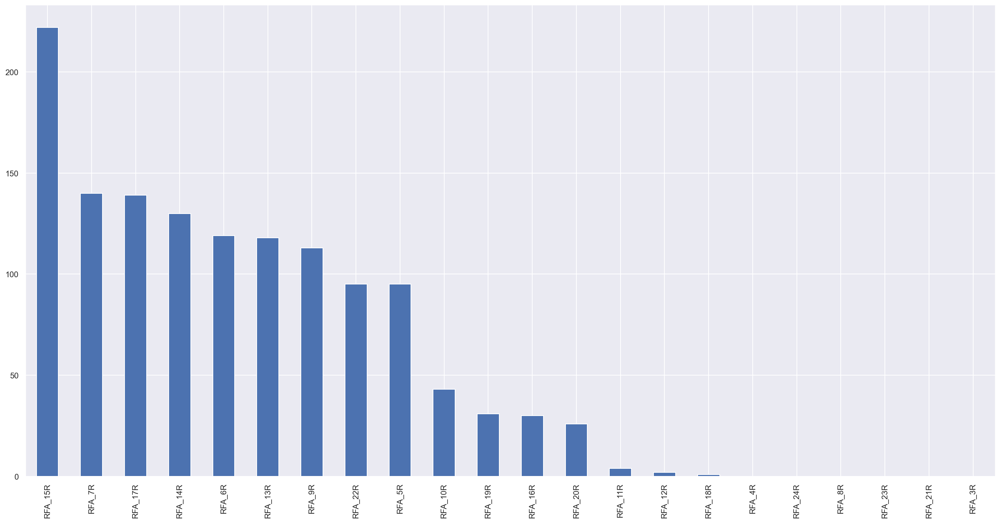

In [166]:
(label_v2.isin(promo_ai)[(label_v2.isin(promo_ai)== True).any(axis = 1)].sum() + label_v2.isin(promo_si)[(label_v2.isin(promo_si)== True).any(axis = 1)].sum()).sort_values(ascending = False).plot.bar()

- Promos:15(by far)/7/17/14

#### Cluster 3

<AxesSubplot:>

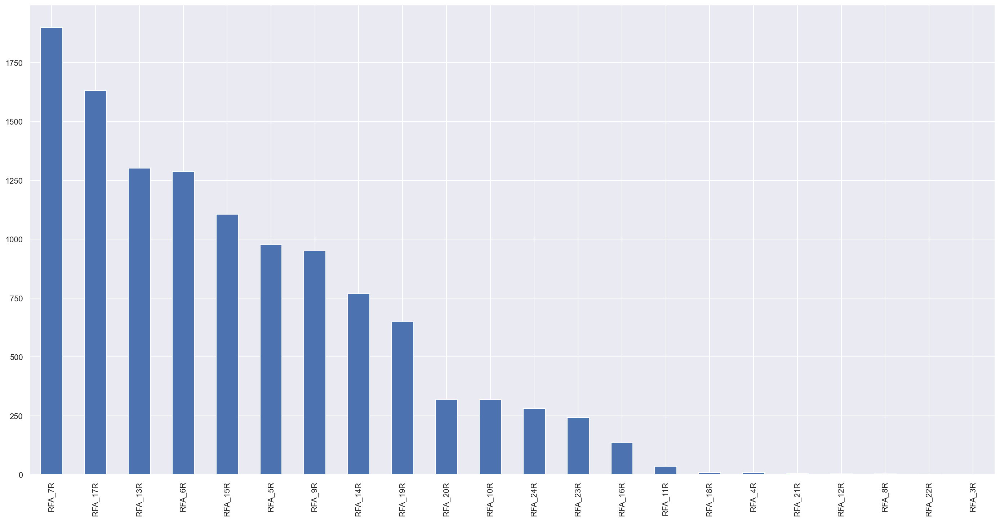

In [167]:
(label_v3.isin(promo_al)[(label_v3.isin(promo_al)== True).any(axis = 1)].sum() + label_v3.isin(promo_sl)[(label_v3.isin(promo_sl)== True).any(axis = 1)].sum()).sort_values(ascending = False).plot.bar()

- Promos: 7/17(by far) / 13/ 6

<AxesSubplot:>

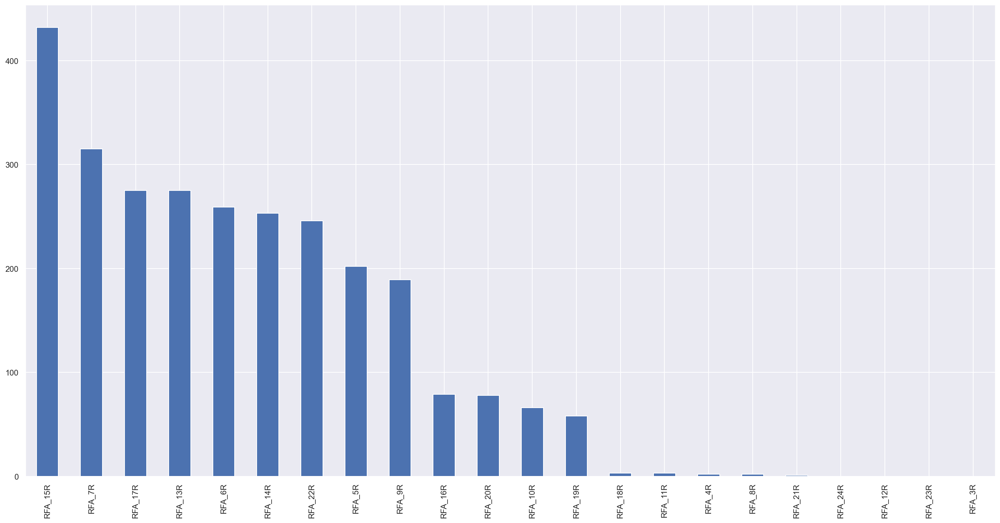

In [168]:
(label_v3.isin(promo_ai)[(label_v3.isin(promo_ai)== True).any(axis = 1)].sum() + label_v3.isin(promo_si)[(label_v3.isin(promo_si)== True).any(axis = 1)].sum()).sort_values(ascending = False).plot.bar()

- Promos:15(by far)/7

Conclusion: 
-  After watching all this barplots , it is possible to conclude the following:
 -  Promotions like 7 and 17 are crucial for getting back lapsed donors;
 -  Promotions like 15,7, and 14 are better for inactive donors(honorable mention to promotion 22);

#### Let's just watch the timing of these promotions

In [169]:
data[['ADATE_7','ADATE_14','ADATE_15','ADATE_17']].mode()

,ADATE_7,ADATE_14,ADATE_15,ADATE_17
0,2016-02-01,2015-06-01,2015-04-01,2015-02-01


So, sending promotions in February would be best timing to create and send some campaign for donors that already went lapsed one time in their donors historical

#### Total Donors Activity/Behaviour by cluster :

#### Cluster 0

In [170]:
print('Lapsed-Active: ',len(label_v0[(matched_al == True).any(axis = 1)]) + len(label_v0[(matched_sl == True).any(axis = 1)]))
print('Inactive-Active: ',len(label_v0[(matched_ai == True).any(axis = 1)]) + len(label_v0[(matched_si == True).any(axis = 1)]))


Lapsed-Active:  4256
Inactive-Active:  1005


#### Cluster 1

In [171]:
print('Lapsed-Active: ',len(label_v1[(matched_al == True).any(axis = 1)]) + len(label_v1[(matched_sl == True).any(axis = 1)]))
print('Inactive-Active: ',len(label_v1[(matched_ai == True).any(axis = 1)]) + len(label_v1[(matched_si == True).any(axis = 1)]))


Lapsed-Active:  1788
Inactive-Active:  446


#### Cluster 2

In [172]:
print('Lapsed-Active: ',len(label_v2[(matched_al == True).any(axis = 1)]) + len(label_v2[(matched_sl == True).any(axis = 1)]))

print('Inactive-Active: ',len(label_v2[(matched_ai == True).any(axis = 1)]) + len(label_v2[(matched_si == True).any(axis = 1)]))


Lapsed-Active:  6304
Inactive-Active:  1263


#### Cluster 3

In [173]:
print('Lapsed-Active: ',len(label_v3[(matched_al == True).any(axis = 1)]) + len(label_v3[(matched_sl == True).any(axis = 1)]))

print('Inactive-Active: ',len(label_v3[(matched_ai == True).any(axis = 1)]) + len(label_v3[(matched_si == True).any(axis = 1)]))

Lapsed-Active:  11296
Inactive-Active:  2670


Marketing Approach:
- Promotions to keep an eye on(descending order in importance):
 - RFA_7   -->    G1  ---> mailings are calendars with stickers but do not have labels
 - RFA_17  -->    G1  ---> mailings are calendars with stickers but do not have labels
 - RFA_13  -->    FS  ---> mailings are blank cards that fold into thirds with labels
 - RFA_6   -->    LL  ---> mailings had labels only
 - RFA_15  -->    TK  ---> mailings have thank you printed on the outside with labels
 - RFA_5   -->    SK  ---> mailings are blank cards with labels
 - RFA_9   -->    CC  ---> mailings are calendars with stickers but do not have labels
 - RFA_14  -->    NK  ---> mailings are blank cards with labels
 - RFA_19  -->    CC  ---> mailings are calendars with stickers but do not have labels
 - RFA_22(exclusively for inactive) -->  XK ---> mailings are Christmas cards with labels

#### Financial aspect

In [174]:
financial_label = pd.concat([labeled_data,data[['AVGGIFT','RAMNTALL','NUMPROM','MDMAUD','Months','STATE']]],axis = 1)

In [175]:
financial_label

,DOMAIN_SES,DOMAIN_Urban,sum_interests,Rich_Neigh,Single_Neigh,Standard_Neigh,Poor/Lower Neigh,WW2,Fed_Act,Korean,Vietnam,label,AVGGIFT,RAMNTALL,NUMPROM,MDMAUD,Months,STATE
CONTROLN,,,,,,,,,,,,,,,,,,
95515,3.0,2.0,0.0,-1.463731,-0.644142,0.529269,0.030194,0.905518,-0.705231,-0.019173,0.743390,3,7.741935,240.0,74,0,18,IL
148535,4.0,3.0,0.0,2.771247,-1.716517,0.076998,1.581860,-2.286216,-0.459178,0.105255,1.043966,3,15.666667,47.0,32,0,18,CA
15078,3.0,1.0,0.0,-2.353468,-0.722082,-0.052250,0.886842,-1.236227,-0.785203,1.152990,0.447734,1,7.481481,202.0,63,0,18,NC
172556,3.0,1.0,0.0,-1.372858,-0.713307,-0.868914,1.054940,-0.436467,-0.551575,-0.053667,1.894853,3,6.812500,109.0,66,0,18,CA
7112,3.0,3.0,7.0,-1.042552,2.288836,-0.279698,0.700694,0.981471,-0.475387,0.156279,-0.868160,2,6.864865,254.0,113,0,17,FL
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
184568,3.0,4.0,0.0,1.732689,0.375044,-0.519483,-1.184765,0.592163,4.278291,-0.142936,-0.440634,3,25.000000,25.0,14,0,16,AK
122706,4.0,4.0,0.0,2.909427,-1.507167,0.108960,0.074607,-0.748546,0.591129,-2.090450,-1.439048,3,20.000000,20.0,10,0,15,TX
189641,2.0,4.0,0.0,0.491400,1.830218,-0.771767,-1.103499,-2.220065,-0.043352,2.757464,-2.583425,0,8.285714,58.0,33,0,8,MI


In [176]:
financial_label[['label','MDMAUD']].groupby(by = 'label').sum()

,MDMAUD
label,
0,59
1,14
2,57
3,156


In [177]:
financial_label[['label','AVGGIFT']].groupby(by = 'label').mean()

,AVGGIFT
label,
0,13.804161
1,12.362281
2,12.860998
3,13.567907


Average Gift should not be the feature to considerate since, for our strategy, the most important aspect is to regain the donor... So, in our to achieve this purpose, NUMPROM should be the feature responsible to differentiate each cluster, following business thought process where a person that buys/donates more times, has a higher chance of donating/buying the product/brand again.

In [178]:
financial_label[['label','RAMNTALL']].groupby(by = 'label').sum()

,RAMNTALL
label,
0,1810111.77
1,733453.34
2,2470073.38
3,4795197.37


Although this feature is, usually, very dependent from the number of donations, cluster 2 and 3 has a huge amount of donations in value

In [179]:
financial_label[['label','NUMPROM']].groupby(by = 'label').sum()

,NUMPROM
label,
0,793139
1,345146
2,1169245
3,2112703


The first cluster that should be targeted by a strategy of promotions campaign should be either the cluster 2 or 3 since they usually donate more often. So, the probability of donating one more time is way higher

### Exploring by State

In order to have accurate strategy of targetting and avoid shipping costs, it was decided to observe which states should be preferred

In [180]:
def usa_map(data,x,y):
    fig = go.Figure(data=go.Choropleth(
        locations=data[x], # Spatial coordinates
        z = data[y].astype(int), # Data to be color-coded
        locationmode = 'USA-states', # set of locations match entries in `locations`
        colorscale = 'greens',
        colorbar_title = "Number of PVA Donors ",
    ))

    fig.update_layout(
        title_text = 'PVA Donors by US County',
        geo_scope='usa', # limite map scope to USA
    )

    fig.show()

In [181]:
label_0 = financial_label[(financial_label.label == 0)]
label_1 = financial_label[(financial_label.label == 1)]
label_2 = financial_label[(financial_label.label == 2)]
label_3 = financial_label[(financial_label.label == 3)]

 #### Cluster 0

In [182]:
label_0_donors = label_0[['STATE','DOMAIN_Urban']].groupby(by = ['STATE']).count().sort_values(by = ['DOMAIN_Urban'], ascending = False).reset_index()
label_0_donors.rename({'DOMAIN_Urban' : 'Number_of_Donors'}, axis = 1, inplace = True)

In [183]:
usa_map(label_0_donors,'STATE','Number_of_Donors')

#### Cluster 1

In [184]:
label_1_donors = label_1[['STATE','DOMAIN_Urban']].groupby(by = ['STATE']).count().sort_values(by = ['DOMAIN_Urban'], ascending = False).reset_index()
label_1_donors.rename({'DOMAIN_Urban' : 'Number_of_Donors'}, axis = 1, inplace = True)

In [185]:
usa_map(label_1_donors,'STATE','Number_of_Donors')

#### Cluster 2

In [186]:
label_2_donors = label_2[['STATE','DOMAIN_Urban']].groupby(by = ['STATE']).count().sort_values(by = ['DOMAIN_Urban'], ascending = False).reset_index()
label_2_donors.rename({'DOMAIN_Urban' : 'Number_of_Donors'}, axis = 1, inplace = True)

In [187]:
usa_map(label_2_donors,'STATE','Number_of_Donors')

#### Cluster 3

In [188]:
label_3_donors = label_3[['STATE','DOMAIN_Urban']].groupby(by = ['STATE']).count().sort_values(by = ['DOMAIN_Urban'], ascending = False).reset_index()
label_3_donors.rename({'DOMAIN_Urban' : 'Number_of_Donors'}, axis = 1, inplace = True)

In [189]:
usa_map(label_3_donors,'STATE','Number_of_Donors')

From those plots above, it is possible to conclude that all donors belonging to cluster 0,2 and 3 are mainly from California, Texas, Florida and Illanois; This means that those states should be the first one to reach out too

Cluster 1 are almost exclusively from the Mid West and South East(specially Texas, Georgia and New York)

## END